In [1]:
%matplotlib inline
import matplotlib as mlp
mlp.rcParams['figure.dpi'] = 200

# diasbling warning messages
import warnings
warnings.filterwarnings("ignore")

# importing key libraries
import pandas as pd
pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.2f}'.format

# numpy import
import numpy as np

# scipy import
import scipy.stats as stats
from math import sqrt

import datetime

# importing acquire module
import acquire
from acquire import get_zillow_dataset, \
                    null_df, \
                    drop_nulls, \
                    clean_zillow_dataset, \
                    train_validate_test_split

# importing data visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set(style = "darkgrid")

# sklearn data science library
from sklearn.impute import KNNImputer
from sklearn.impute import MissingIndicator
from sklearn.experimental import enable_iterative_imputer
from sklearn.metrics import mean_squared_error
from sklearn.impute import IterativeImputer
from sklearn.cluster import KMeans

from sklearn.preprocessing import RobustScaler, StandardScaler, MinMaxScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression, LassoLars, TweedieRegressor
from sklearn.feature_selection import SelectKBest, RFE, f_regression

In [2]:
# data acquisition and preparation

df = get_zillow_dataset()
print(df.shape)

(52319, 68)


In [3]:
# initial clean of dataset 
# where: feature and record null % > 80% are dropped

df = clean_zillow_dataset(df)
df.head()

dataframe shape: (52238, 14)


,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,transaction_date,year_built
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,2017-01-01,1998.00
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,2017-01-01,1967.00
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,2017-01-01,1962.00
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,2017-01-01,1970.00
4,12095076,773303.00,-0.00,3.00,4.00,2962.00,LA County,34145202.00,-118179824.00,63000.00,0101,60374608.001014,2017-01-01,1950.00


In [4]:
# calculating and adding age of the home thru 2017

df = acquire.age_of_homes(df)
df.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,transaction_date,year_built,home_age
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,2017-01-01,1998.00,19.00
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,2017-01-01,1967.00,50.00
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,2017-01-01,1962.00,55.00
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,2017-01-01,1970.00,47.00
4,12095076,773303.00,-0.00,3.00,4.00,2962.00,LA County,34145202.00,-118179824.00,63000.00,0101,60374608.001014,2017-01-01,1950.00,67.00


In [5]:
# retrieving numerical column lower/upper bound outliers 

holder = []
num_lst = df.select_dtypes("number").columns.tolist()
num_lst = [ele for ele in num_lst if ele not in ("parcel_id", 'longitude', 'latitude', 'blockgroup_assignment')]
k = 1.5

# determining continuous features/columns
for col in df[num_lst]:
    
    # determing 1st and 3rd quartile
    q1, q3 = df[col].quantile([.25, 0.75])
    
    # calculate interquartile range
    iqr = q3 - q1
    
    # set feature/data lower bound limit
    lower_bound = q1 - k * iqr

    # set feature/data upperbound limit
    upper_bound = q3 + k * iqr
    
    metrics = { 
        "column": col,
        "column type": df[col].dtype,
        "iqr": round(iqr, 5),
        "lower_bound": round(lower_bound, 5),
        "lower_outliers": len(df[df[col] < lower_bound]),
        "upper_bound": round(upper_bound, 5),
        "upper_outliers": len(df[df[col] > upper_bound])
    }

    holder.append(metrics)

num_outliers = pd.DataFrame(holder)
num_outliers

,column,column type,iqr,lower_bound,lower_outliers,upper_bound,upper_outliers
0,home_value,float64,424963.00,-443469.50,0,1256382.50,3507
1,logerror,float64,0.07,-0.12,2625,0.14,3769
2,bathroom_count,float64,1.00,0.50,46,4.50,1577
3,bedroom_count,float64,1.00,1.50,670,5.50,777
4,living_sq_feet,float64,1038.00,-289.00,0,3863.00,2272
5,property_sq_feet,float64,3204.00,775.00,42,13591.00,5528
6,year_built,float64,29.00,1906.50,240,2022.50,0
7,home_age,float64,29.00,-5.50,0,110.50,240


In [6]:
# shape before cleaning outliers

df.shape

(52238, 15)

In [7]:
# cleaning identified outlier limits

df = acquire.zillow_outliers(df)
df.shape

(38293, 15)

In [8]:
# adding transactions by month columns

df = acquire.clean_months(df)
df.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,1998.00,19.00,January
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,1967.00,50.00,January
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,1962.00,55.00,January
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,1970.00,47.00,January
5,12069064,218552.00,0.10,1.00,2.00,738.00,LA County,34149214.00,-118239357.00,4214.00,0100,60373020.041001,1922.00,95.00,January


In [9]:
# df['example1'] = pd.to_datetime(df.transaction_date).dt.to_period('m')
# df['example1'].head()

In [10]:
# df['example2'] = pd.to_datetime(df.transaction_date).dt.strftime('%m/%Y')
# df.example2.head()

In [11]:
# dataframe info

sorted_cols = df.columns.sort_values()
df[sorted_cols].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38293 entries, 0 to 52318
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   bathroom_count         38293 non-null  float64
 1   bedroom_count          38293 non-null  float64
 2   blockgroup_assignment  38293 non-null  object 
 3   county_by_fips         38293 non-null  object 
 4   county_zoning_code     38293 non-null  object 
 5   home_age               38293 non-null  float64
 6   home_value             38293 non-null  float64
 7   latitude               38293 non-null  float64
 8   living_sq_feet         38293 non-null  float64
 9   logerror               38293 non-null  float64
 10  longitude              38293 non-null  float64
 11  parcel_id              38293 non-null  object 
 12  property_sq_feet       38293 non-null  float64
 13  transaction_month      38293 non-null  object 
 14  year_built             38293 non-null  float64
dtypes:

In [12]:
# checking initial dataset nulls and percentage of dataframe features

remaining_nulls = null_df(df)
remaining_nulls

,Total Null,Feature Null %
parcel_id,0,0.00
home_value,0,0.00
logerror,0,0.00
bathroom_count,0,0.00
bedroom_count,0,0.00
living_sq_feet,0,0.00
county_by_fips,0,0.00
latitude,0,0.00
longitude,0,0.00
property_sq_feet,0,0.00


In [13]:
# summing total number of outliers per continuous feature - target variable

acquire.sum_outliers(df)

,Feature,Upper_Bound,Total Outliers
0,property_sq_feet,11265.00,1458
1,bathroom_count,3.25,1453
2,living_sq_feet,3240.50,897
3,home_value,1047231.50,748
4,home_age,107.50,102


In [14]:
# identifying continuous variables/features:

num_lst = df.select_dtypes("number").columns.tolist()
num_lst = [ele for ele in num_lst if ele not in ("logerror", "parcel_id", "year_built")]
num_lst

['home_value',
 'bathroom_count',
 'bedroom_count',
 'living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'home_age']

In [15]:
# let's handle the outliers using a upper bound "capping" method

# df = acquire.clean_outliers(df)
df.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,1998.00,19.00,January
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,1967.00,50.00,January
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,1962.00,55.00,January
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,1970.00,47.00,January
5,12069064,218552.00,0.10,1.00,2.00,738.00,LA County,34149214.00,-118239357.00,4214.00,0100,60373020.041001,1922.00,95.00,January


In [16]:
# checking the dataframe shape after capping outliers

df.shape

(38293, 15)

----
### **``splitting zillow dataset and cleaning remaining nulls/missing values:``**

In [17]:
# splitting the dataset to 1. fill-in remaining nulls and 2. determine outlier cutoffs

train, validate, test = train_validate_test_split(df)

train shape: (21443, 15)
validate shape: (9191, 15)
test shape: (7659, 15)


In [18]:
# creating a new continuous feature list in datasets

num_lst = train.select_dtypes("number").columns.tolist()
num_lst = [ele for ele in num_lst if ele not in ("logerror", "home_value")]
num_lst

['bathroom_count',
 'bedroom_count',
 'living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'year_built',
 'home_age']

In [19]:
# checking train dataset for remaining nulls

null_df = null_df(train)
null_df

,Total Null,Feature Null %
parcel_id,0,0.00
home_value,0,0.00
logerror,0,0.00
bathroom_count,0,0.00
bedroom_count,0,0.00
living_sq_feet,0,0.00
county_by_fips,0,0.00
latitude,0,0.00
longitude,0,0.00
property_sq_feet,0,0.00


In [20]:
# checking dataframe after split

train.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42200101,1958.00,59.00,February
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.071008,1972.00,45.00,June
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.001022,1991.00,26.00,May
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.003017,1950.00,67.00,April
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.021002,1998.00,19.00,May


In [21]:
# using sklearn's iterative imputer to fill-in remaining nulls

def train_iterative_imputer(train_df):

        # placeholder for continuous features
        num_lst = [
        'home_value',
        'bathroom_count',
        'bedroom_count',
        'living_sq_feet',
        'latitude',
        'longitude',
        'property_sq_feet',
        'blockgroup_assignment',
        'year_built',
        'home_age']

        # creating the "thing"
        imputer = IterativeImputer(
                missing_values = np.nan, \
                skip_complete = True, \
                random_state = 123)
        
        # fitting the "thing" and transforming it
        imputed = imputer.fit_transform(train_df[num_lst])

           # create a new dataframe with learned imputed data
        train_df_imputed = pd.DataFrame(imputed, index = train_df.index)

        # filling in missing values from learned imputer
        train_df[num_lst] = train_df_imputed

        # return the new imputed df
        return train_df

In [22]:
# let's fit the imputer and return it

train_imputed = train_iterative_imputer(train)
train_imputed.isnull().sum()

parcel_id                0
home_value               0
logerror                 0
bathroom_count           0
bedroom_count            0
living_sq_feet           0
county_by_fips           0
latitude                 0
longitude                0
property_sq_feet         0
county_zoning_code       0
blockgroup_assignment    0
year_built               0
home_age                 0
transaction_month        0
dtype: int64

In [23]:
# let's transform validate and test datasets

num_lst = [
        'bathroom_count',
        'bedroom_count',
        'living_sq_feet',
        'latitude',
        'longitude',
        'property_sq_feet',
        'blockgroup_assignment',
        'year_built',
        'home_age']

# creating the "thing"
imputer = IterativeImputer(
        missing_values = np.nan, \
        skip_complete = True, \
        random_state = 123)

# fitting the "thing" and transforming it
imputed = imputer.fit(train[num_lst])

val_imputed = imputed.transform(validate[num_lst])
X_validate_imputed = pd.DataFrame(val_imputed, index = validate.index)
validate[num_lst] = X_validate_imputed
validate_imputed = validate

test_imputed = imputed.transform(test[num_lst])
test_imputed = pd.DataFrame(test_imputed, index = test.index)
test[num_lst] = test_imputed
test_imputed = test

# checking the dataset for nulls
print('null results in: validate')
print('----------------------------|---------')
print(f'{validate_imputed.isnull().sum()}')
print()
print('null results in: test')
print('----------------------------|---------')
print(f'{test_imputed.isnull().sum()}')

null results in: validate
----------------------------|---------
parcel_id                0
home_value               0
logerror                 0
bathroom_count           0
bedroom_count            0
living_sq_feet           0
county_by_fips           0
latitude                 0
longitude                0
property_sq_feet         0
county_zoning_code       0
blockgroup_assignment    0
year_built               0
home_age                 0
transaction_month        0
dtype: int64

null results in: test
----------------------------|---------
parcel_id                0
home_value               0
logerror                 0
bathroom_count           0
bedroom_count            0
living_sq_feet           0
county_by_fips           0
latitude                 0
longitude                0
property_sq_feet         0
county_zoning_code       0
blockgroup_assignment    0
year_built               0
home_age                 0
transaction_month        0
dtype: int64


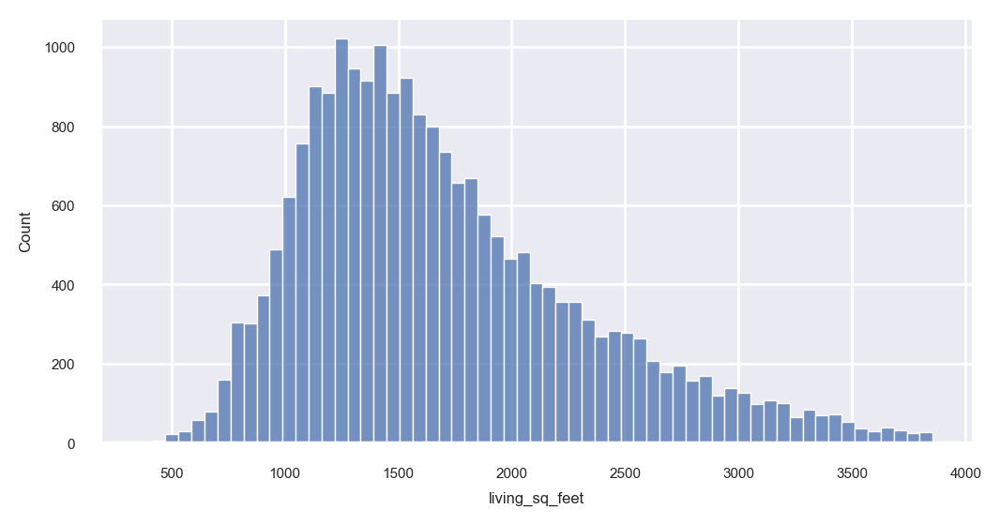

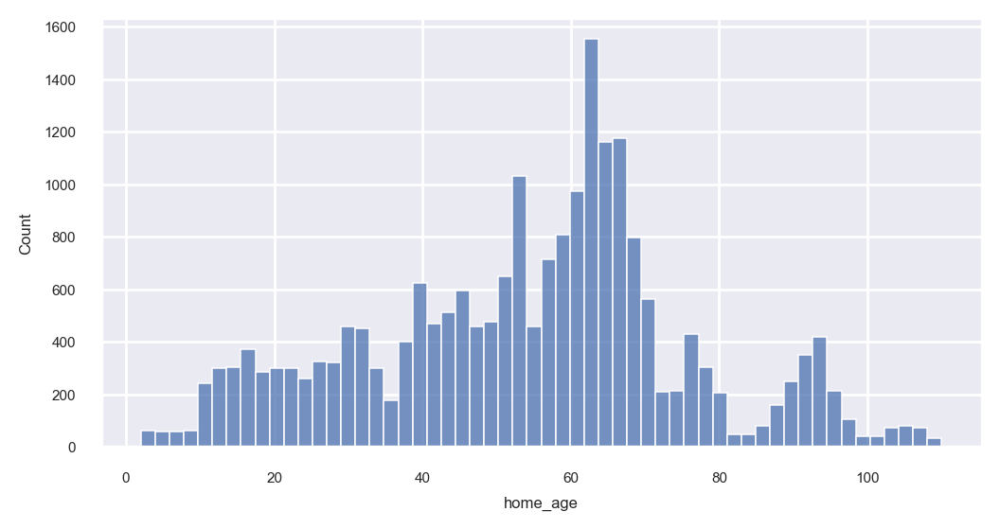

In [24]:
# let's bin the following features:

# living sq. feet = relative size of the home (<1K, 1-2K, 2-3K, 4K, etc.)
# home age = relative age of the home (e.g., recent build, mid-century, early-century, last-century, etc.)

for col in train_imputed[["living_sq_feet", "home_age"]]:
    plt.figure(figsize = (6, 3))
    sns.set(font_scale = .5)
    
    sns.histplot(train_imputed[col])
    plt.show()


In [25]:
pd.qcut(
    train_imputed["home_age"],
    q = 4).unique()

[(57.0, 67.0], (40.0, 57.0], (1.999, 40.0], (67.0, 110.0]]
Categories (4, interval[float64, right]): [(1.999, 40.0] < (40.0, 57.0] < (57.0, 67.0] < (67.0, 110.0]]

In [26]:
# pandas cut method on Home Age
# [(0.999, 38.0] > (38.0, 57.0] > (57.0, 67.0], (67.0, 110.5]]

age_labels = ["new_century", "late_20th_century", "mid_20th_century", "early_20th_century"]

train_imputed["home_age_binned"] = pd.qcut(
    train_imputed["home_age"],
    q = 4,
    labels = age_labels)

validate_imputed["home_age_binned"] = pd.qcut(
    validate_imputed["home_age"], 
    q = 4, 
    labels = age_labels)

test_imputed["home_age_binned"] = pd.qcut(
    test_imputed["home_age"], 
    q = 4, 
    labels = age_labels)

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,59.00,February,mid_20th_century
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,45.00,June,late_20th_century
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,26.00,May,new_century
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,67.00,April,mid_20th_century
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,19.00,May,new_century


In [27]:
# home time period

train_imputed[train_imputed["home_age_binned"] == "early_20th_century"].year_built.min()

# 1977 - 2015
# 1960 - 1976
# 1950 - 1959
# 1907 - 1949

1907.0

In [28]:
# checking validate dataset

validate_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned
7055,11390194,187541.00,-0.04,2.00,3.00,1661.00,LA County,33982335.00,-118347532.00,6750.00,0100,60372351.00,1941.00,76.00,February,early_20th_century
28796,11319934,294000.00,-0.02,3.00,4.00,2430.00,LA County,34649872.00,-118239408.00,9733.00,0100,60379012.05,1989.00,28.00,June,new_century
42431,13033826,385795.00,-0.03,2.00,3.00,1268.00,LA County,34132157.00,-117868684.00,6157.00,0100,60374011.02,1954.00,63.00,July,mid_20th_century
39139,12471637,491380.00,0.01,1.00,3.00,1098.00,LA County,33844616.00,-118143360.00,5400.00,0100,60375713.00,1952.00,65.00,July,mid_20th_century
10590,12048373,702552.00,0.07,1.00,2.00,1220.00,LA County,34200782.00,-118228785.00,5952.00,0100,60373006.00,1937.00,80.00,March,early_20th_century


In [29]:
pd.qcut(
    train_imputed["living_sq_feet"], \
    q = 4).unique()

[(1241.0, 1566.0], (359.999, 1241.0], (2037.0, 3855.0], (1566.0, 2037.0]]
Categories (4, interval[float64, right]): [(359.999, 1241.0] < (1241.0, 1566.0] < (1566.0, 2037.0] < (2037.0, 3855.0]]

In [30]:
# pandas cut method on Living Sq. Feet
# [(127.999, 1267.0] < (1267.0, 1654.0] < (1654.0, 2299.0] < (2299.0, 3863.0]]

sq_ft_labels = ["360_to_1240_sqfeet", "1241_to_1565_sqfeet", "1566_to_2036_sqfeet", "2037_to_3855_sqfeet"]

train_imputed["living_sqfeet_binned"] = pd.qcut(
    train_imputed["living_sq_feet"], \
    q = 4, \
    labels = sq_ft_labels)

validate_imputed["living_sqfeet_binned"] = pd.qcut(
    validate_imputed["living_sq_feet"], \
    q = 4, \
    labels = sq_ft_labels)

test_imputed["living_sqfeet_binned"] = pd.qcut(
    test_imputed["living_sq_feet"], \
    q = 4, \
    labels = sq_ft_labels)

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,59.00,February,mid_20th_century,1241_to_1565_sqfeet
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,45.00,June,late_20th_century,360_to_1240_sqfeet
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,26.00,May,new_century,2037_to_3855_sqfeet
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,67.00,April,mid_20th_century,2037_to_3855_sqfeet
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,19.00,May,new_century,2037_to_3855_sqfeet


In [31]:
# let's create a transaction seasons/yearly quarter column by using transaction months

sorted(train_imputed["transaction_month"].unique())

['April',
 'August',
 'February',
 'January',
 'July',
 'June',
 'March',
 'May',
 'September']

In [32]:
# let's create the quarter columns

# train dataset
train_imputed["q1_transaction"] = (train_imputed["transaction_month"] == "January") | (train_imputed["transaction_month"] == "February") | (train_imputed["transaction_month"] == "March")
train_imputed["q2_transaction"] = (train_imputed["transaction_month"] == "April") | (train_imputed["transaction_month"] == "May") | (train_imputed["transaction_month"] == "June")
train_imputed["q3_transaction"] = (train_imputed["transaction_month"] == "July") | (train_imputed["transaction_month"] == "August") | (train_imputed["transaction_month"] == "September")

# validate dataset
validate_imputed["q1_transaction"] = (validate_imputed["transaction_month"] == "January") | (validate_imputed["transaction_month"] == "February") | (validate_imputed["transaction_month"] == "March")
validate_imputed["q2_transaction"] = (validate_imputed["transaction_month"] == "April") | (validate_imputed["transaction_month"] == "May") | (validate_imputed["transaction_month"] == "June")
validate_imputed["q3_transaction"] = (validate_imputed["transaction_month"] == "July") | (validate_imputed["transaction_month"] == "August") | (validate_imputed["transaction_month"] == "September")

# test dataset
test_imputed["q1_transaction"] = (test_imputed["transaction_month"] == "January") | (test_imputed["transaction_month"] == "February") | (test_imputed["transaction_month"] == "March")
test_imputed["q2_transaction"] = (test_imputed["transaction_month"] == "April") | (test_imputed["transaction_month"] == "May") | (test_imputed["transaction_month"] == "June")
test_imputed["q3_transaction"] = (test_imputed["transaction_month"] == "July") | (test_imputed["transaction_month"] == "August") | (test_imputed["transaction_month"] == "September")


train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,q1_transaction,q2_transaction,q3_transaction
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,59.00,February,mid_20th_century,1241_to_1565_sqfeet,True,False,False
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,45.00,June,late_20th_century,360_to_1240_sqfeet,False,True,False
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,26.00,May,new_century,2037_to_3855_sqfeet,False,True,False
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,67.00,April,mid_20th_century,2037_to_3855_sqfeet,False,True,False
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,19.00,May,new_century,2037_to_3855_sqfeet,False,True,False


In [33]:
# let's look at the dataframe column types

train_imputed.dtypes

parcel_id                  object
home_value                float64
logerror                  float64
bathroom_count            float64
bedroom_count             float64
living_sq_feet            float64
county_by_fips             object
latitude                  float64
longitude                 float64
property_sq_feet          float64
county_zoning_code         object
blockgroup_assignment     float64
year_built                float64
home_age                  float64
transaction_month          object
home_age_binned          category
living_sqfeet_binned     category
q1_transaction               bool
q2_transaction               bool
q3_transaction               bool
dtype: object

In [34]:
# listing discrete/categorical and continuous features

from pandas.api.types import is_string_dtype
from pandas.api.types import is_numeric_dtype

disc_features = []
num_features = []

for col in list(train_imputed.columns):
    if is_numeric_dtype(train_imputed[col]):
        num_features.append(col)
    
    else: disc_features.append(col)

print(f'discrete feature:\n{disc_features}')
print('-------')
print(f'continuous feature:\n{num_features}')

discrete feature:
['parcel_id', 'county_by_fips', 'county_zoning_code', 'transaction_month', 'home_age_binned', 'living_sqfeet_binned']
-------
continuous feature:
['home_value', 'logerror', 'bathroom_count', 'bedroom_count', 'living_sq_feet', 'latitude', 'longitude', 'property_sq_feet', 'blockgroup_assignment', 'year_built', 'home_age', 'q1_transaction', 'q2_transaction', 'q3_transaction']


-----
### **``hypothesis testing``**

In [35]:
# description of continuous variables

summary_stats = train_imputed.describe().T
summary_stats["range"] = summary_stats["max"] - summary_stats["min"]
summary_stats.sort_index()

,count,mean,std,min,25%,50%,75%,max,range
bathroom_count,21443.00,2.11,0.74,1.00,2.00,2.00,2.50,4.50,3.50
bedroom_count,21443.00,3.21,0.81,1.00,3.00,3.00,4.00,5.00,4.00
blockgroup_assignment,21443.00,60500814.38,211648.64,60371011.10,60374034.01,60376207.02,60590524.17,61110091.00,739079.90
home_age,21443.00,53.96,21.71,2.00,40.00,57.00,67.00,110.00,108.00
home_value,21443.00,384934.20,256233.18,13524.00,184977.00,343475.00,530748.00,1255855.00,1242331.00
latitude,21443.00,34014868.10,274137.02,33341224.00,33820821.00,33993581.00,34189123.50,34718286.00,1377062.00
living_sq_feet,21443.00,1696.31,621.60,360.00,1241.00,1566.00,2037.00,3855.00,3495.00
logerror,21443.00,0.01,0.05,-0.12,-0.02,0.00,0.03,0.14,0.26
longitude,21443.00,-118180598.51,359366.75,-119378658.00,-118379999.50,-118126317.00,-117923611.00,-117555373.00,1823285.00
property_sq_feet,21443.00,6668.58,2209.26,776.00,5400.00,6500.00,7742.50,13591.00,12815.00


In [36]:
# let's explore discrete vs. continuous variables/features

for col in list(train_imputed.columns):
    print(f'Feature: {col}')
    print(f'data type: {train_imputed[col].dtype}')
    print(f'number of unique values: {train_imputed[col].nunique()}')
    print()

Feature: parcel_id
data type: object
number of unique values: 21443

Feature: home_value
data type: float64
number of unique values: 17213

Feature: logerror
data type: float64
number of unique values: 21373

Feature: bathroom_count
data type: float64
number of unique values: 8

Feature: bedroom_count
data type: float64
number of unique values: 5

Feature: living_sq_feet
data type: float64
number of unique values: 2833

Feature: county_by_fips
data type: object
number of unique values: 3

Feature: latitude
data type: float64
number of unique values: 21144

Feature: longitude
data type: float64
number of unique values: 21142

Feature: property_sq_feet
data type: float64
number of unique values: 7202

Feature: county_zoning_code
data type: object
number of unique values: 14

Feature: blockgroup_assignment
data type: float64
number of unique values: 16192

Feature: year_built
data type: float64
number of unique values: 109

Feature: home_age
data type: float64
number of unique values: 109

In [37]:
# what is block group assignment

train_imputed["blockgroup_assignment"].head()

6446    60371066.42
34431   60590117.07
22887   60590629.00
20139   60373101.00
22438   60590016.02
Name: blockgroup_assignment, dtype: float64

In [38]:
# let's check the df information

train_imputed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21443 entries, 6446 to 19490
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   parcel_id              21443 non-null  object  
 1   home_value             21443 non-null  float64 
 2   logerror               21443 non-null  float64 
 3   bathroom_count         21443 non-null  float64 
 4   bedroom_count          21443 non-null  float64 
 5   living_sq_feet         21443 non-null  float64 
 6   county_by_fips         21443 non-null  object  
 7   latitude               21443 non-null  float64 
 8   longitude              21443 non-null  float64 
 9   property_sq_feet       21443 non-null  float64 
 10  county_zoning_code     21443 non-null  object  
 11  blockgroup_assignment  21443 non-null  float64 
 12  year_built             21443 non-null  float64 
 13  home_age               21443 non-null  float64 
 14  transaction_month      21443 non-nu

In [39]:
# re-running feature lists

disc_features = []
num_features = []

for col in list(train_imputed.columns):
    if is_numeric_dtype(train_imputed[col]):
        num_features.append(col)
    
    else: disc_features.append(col)

print(f'discrete feature:\n{disc_features}')
print('-------')
print(f'continuous feature:\n{num_features}')

discrete feature:
['parcel_id', 'county_by_fips', 'county_zoning_code', 'transaction_month', 'home_age_binned', 'living_sqfeet_binned']
-------
continuous feature:
['home_value', 'logerror', 'bathroom_count', 'bedroom_count', 'living_sq_feet', 'latitude', 'longitude', 'property_sq_feet', 'blockgroup_assignment', 'year_built', 'home_age', 'q1_transaction', 'q2_transaction', 'q3_transaction']


In [40]:
# logerror absolute value

abs(train_imputed["logerror"]).mean()

0.03452859977411108

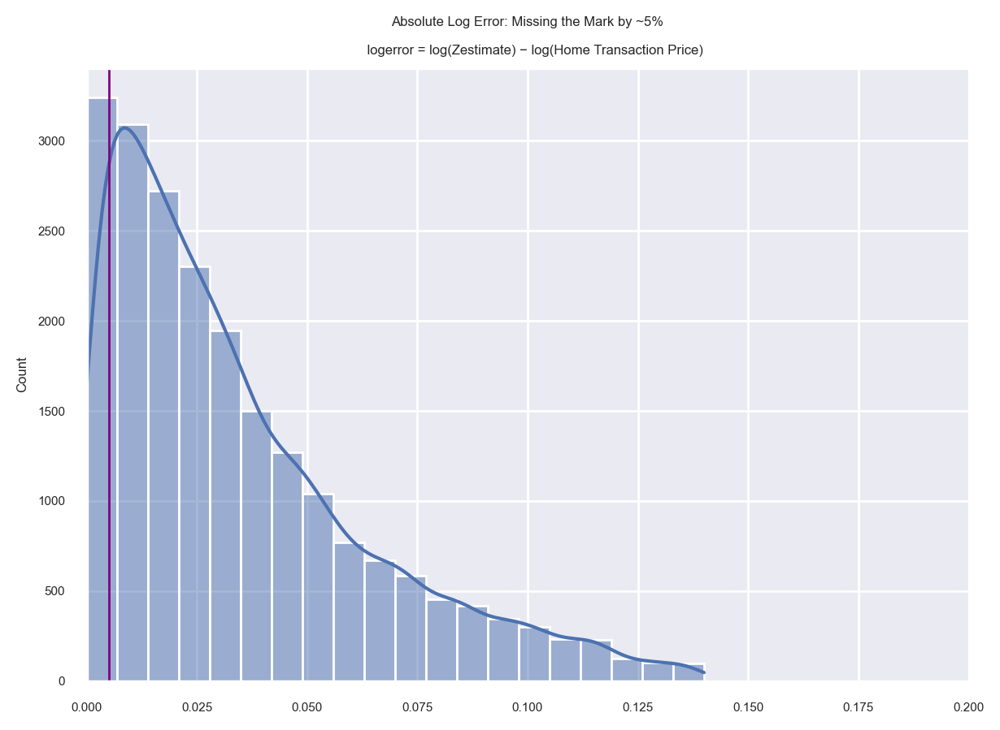

In [41]:
# let's look at absolute value for log error

plt.figure(figsize = (7, 5))
sns.set(font_scale = 0.5)

sns.histplot(
    abs(train_imputed["logerror"]), \
    bins = 20, \
    kde = True)

plt.axvline(abs(train_imputed["logerror"].mean()), 
    linewidth = 1, 
    color = 'purple', 
    label = "mean")
    
# plt.text(0.055, 15500, "7.3% mean logerror", 
#     horizontalalignment = 'left', 
#     size = 'medium', 
#     color = 'purple', 
#     weight = 'semibold')

plt.title('''Absolute Log Error: Missing the Mark by ~5%\n
    logerror = log(Zestimate) − log(Home Transaction Price)''')
plt.xlabel(None)
plt.xlim(0, 0.2)
plt.show()

----
### ``Initial feature relationship plots``

In [42]:
# melting quarter transaction columns

train_imputed["transaction_quarter"] = train_imputed[["q1_transaction", "q2_transaction", "q3_transaction"]].idxmax(1).to_frame('transaction_quarter')
validate_imputed["transaction_quarter"] = validate_imputed[["q1_transaction", "q2_transaction", "q3_transaction"]].idxmax(1).to_frame('transaction_quarter')
test_imputed["transaction_quarter"] = test_imputed[["q1_transaction", "q2_transaction", "q3_transaction"]].idxmax(1).to_frame('transaction_quarter')

# dropping redundant columns

train_imputed.drop(columns = ["q1_transaction", "q2_transaction", "q3_transaction"], inplace = True)
validate_imputed.drop(columns = ["q1_transaction", "q2_transaction", "q3_transaction"], inplace = True)
test_imputed.drop(columns = ["q1_transaction", "q2_transaction", "q3_transaction"], inplace = True)


train.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,59.00,February,mid_20th_century,1241_to_1565_sqfeet,q1_transaction
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,45.00,June,late_20th_century,360_to_1240_sqfeet,q2_transaction
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,26.00,May,new_century,2037_to_3855_sqfeet,q2_transaction
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,67.00,April,mid_20th_century,2037_to_3855_sqfeet,q2_transaction
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,19.00,May,new_century,2037_to_3855_sqfeet,q2_transaction


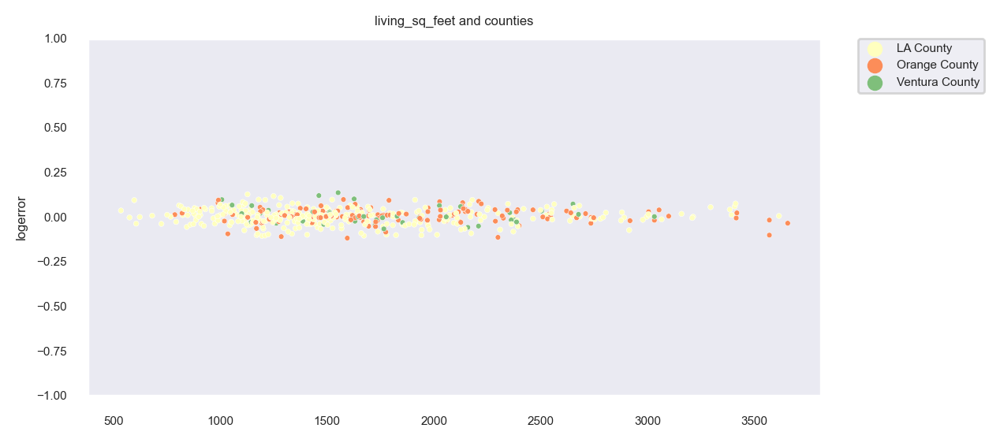

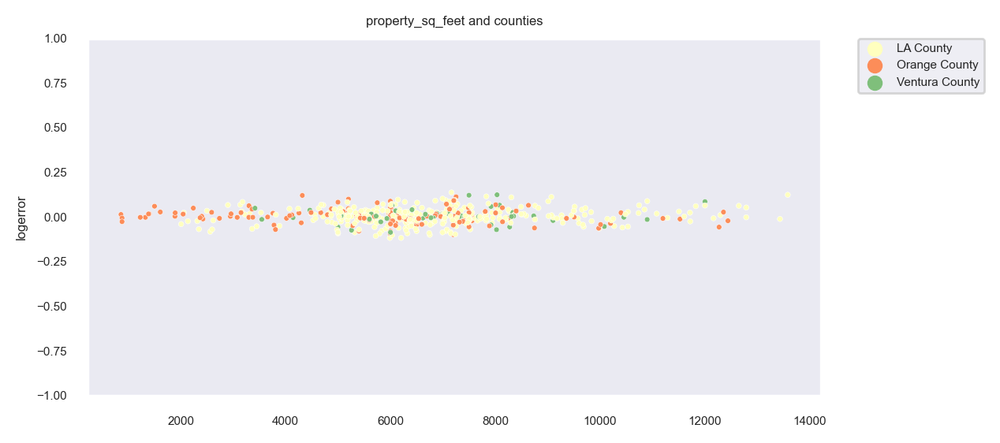

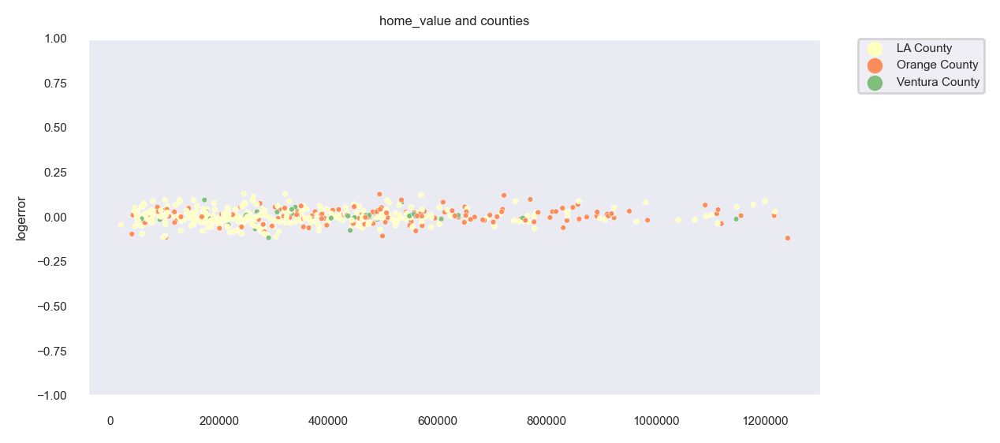

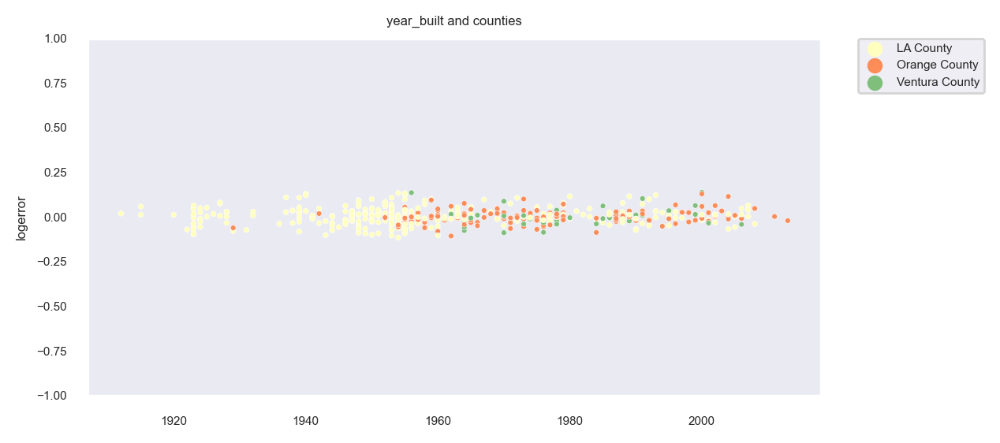

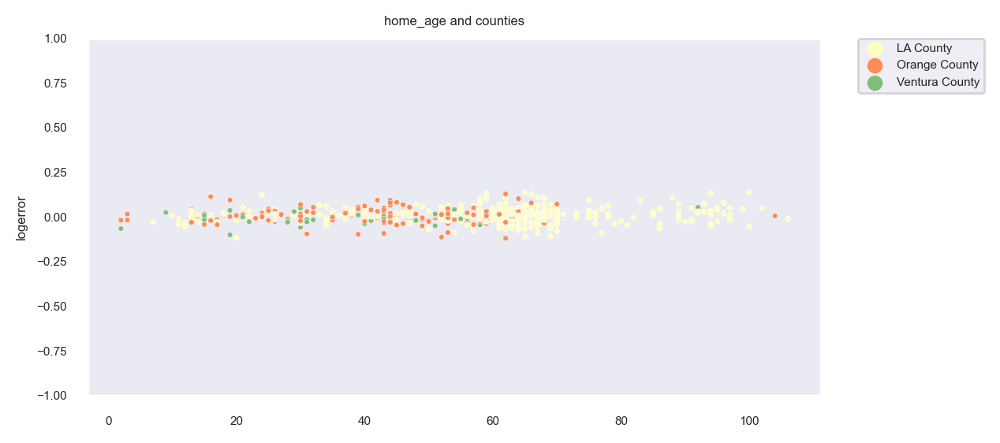

In [43]:
# viewing the log error relationship across continuous features, and counties

num_lst = [
'living_sq_feet',
'property_sq_feet',
'home_value',
'year_built',
'home_age']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    ax = sns.scatterplot(x = col,
        y = "logerror",
        data = train_imputed.sample(500),
        hue = "county_by_fips",
        hue_order = ["LA County", "Orange County", "Ventura County"],
        palette = ["#ffffbf", "#fc8d59", "#7fbf7b"],
        sizes = (20,600),
        s = 6)

    # removing scientific notation
    ax.ticklabel_format(style = "plain")
    
    plt.title(f'{col} and counties')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

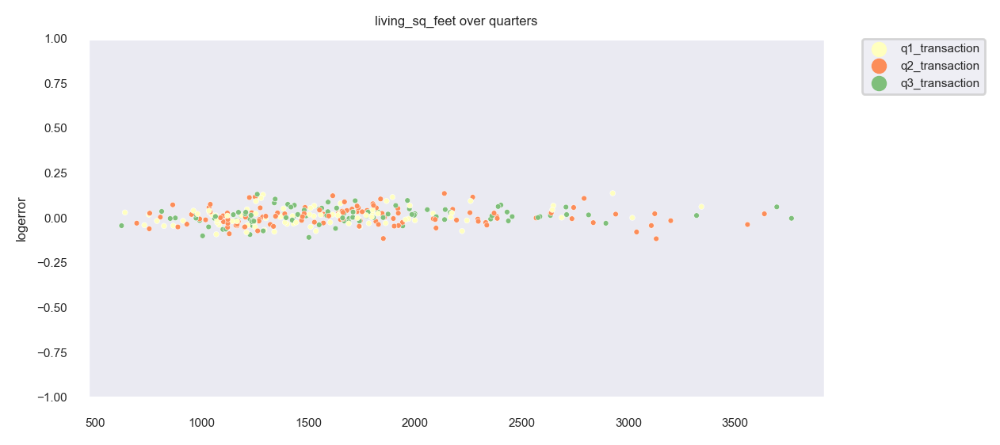

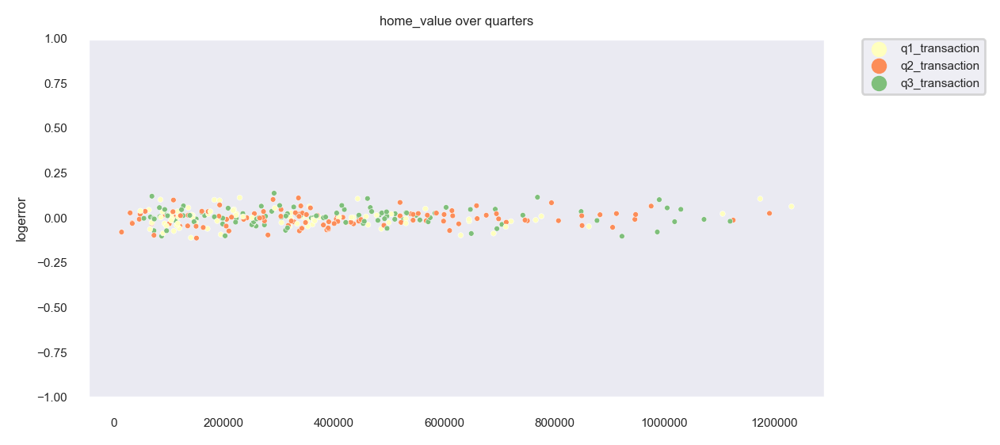

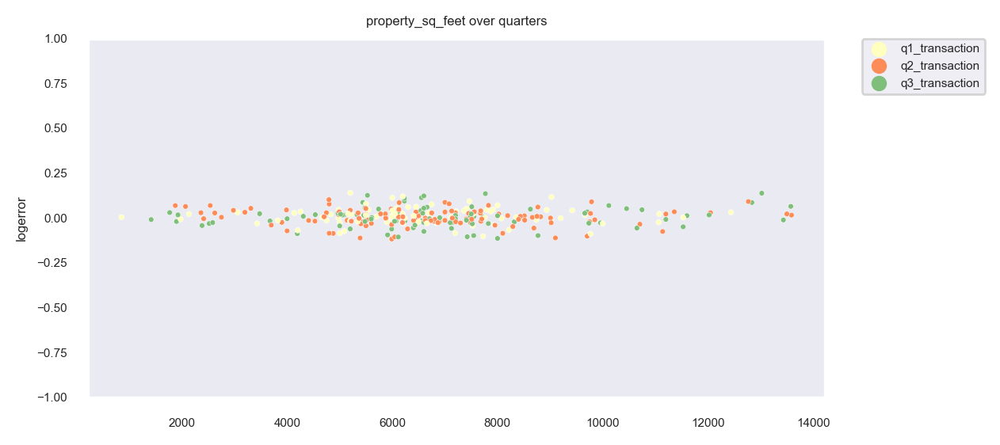

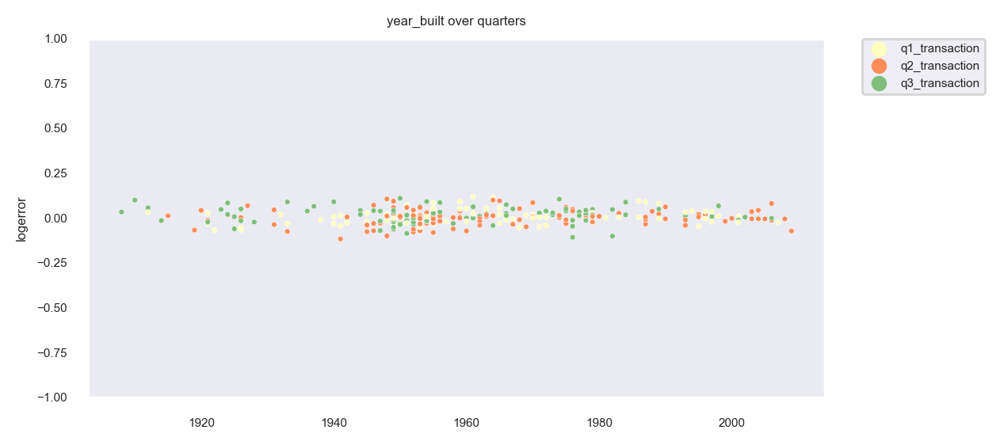

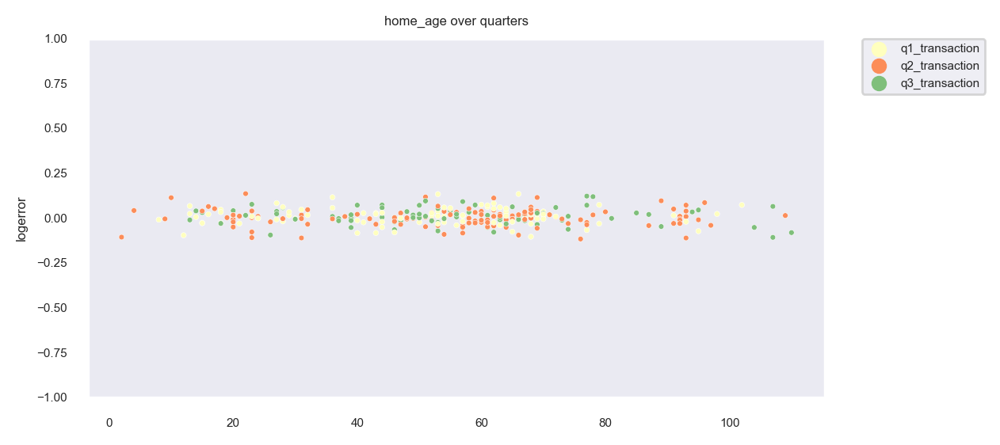

In [44]:
# viewing the log error relationship across continuous features, and transaction quarters

num_lst = [
 'living_sq_feet',
 'home_value',
 'property_sq_feet',
 'year_built',
 'home_age']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    ax = sns.scatterplot(x = col,
        y = "logerror",
        data = train_imputed.sample(300),
        hue = "transaction_quarter",
        hue_order = ["q1_transaction", "q2_transaction", "q3_transaction"],
        palette = ["#ffffbf", "#fc8d59", "#7fbf7b"],
        sizes = (20,600),
        s = 6)

    # removing scientific notation
    ax.ticklabel_format(style = "plain")

    plt.title(f'{col} over quarters')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    # plt.savefig(title, dpi=300)

    plt.show()

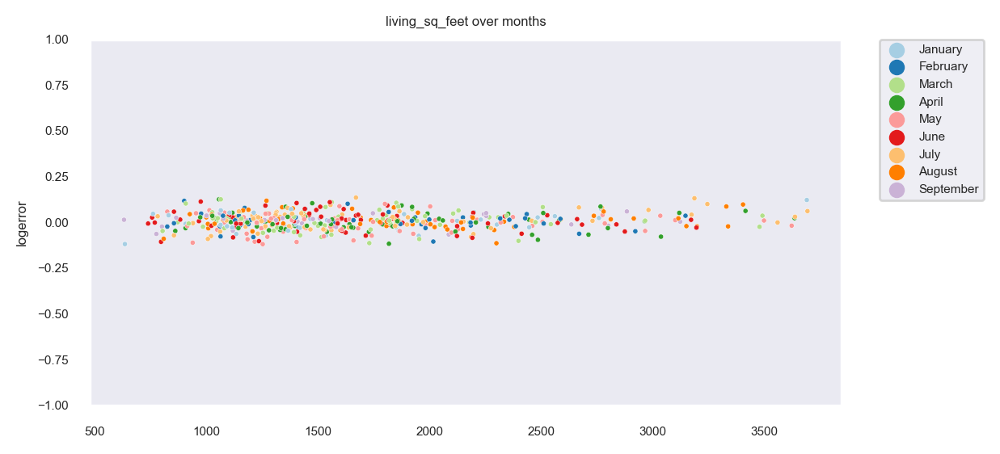

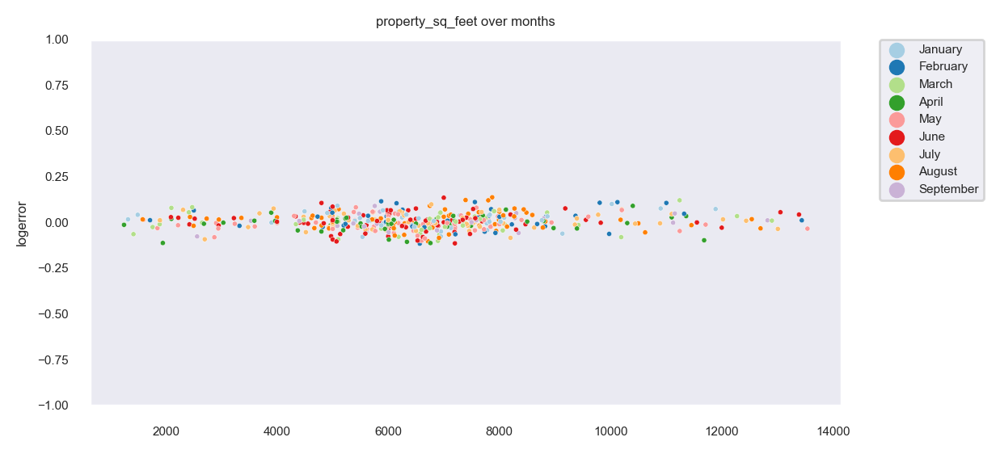

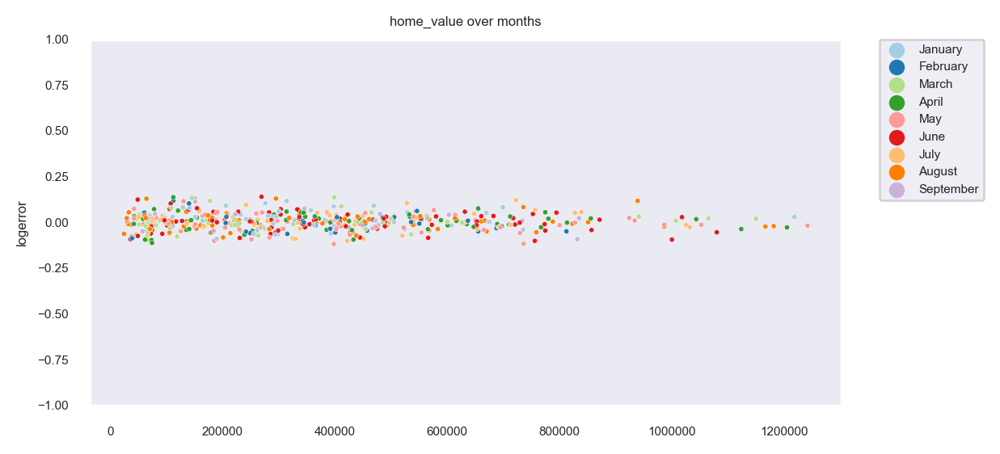

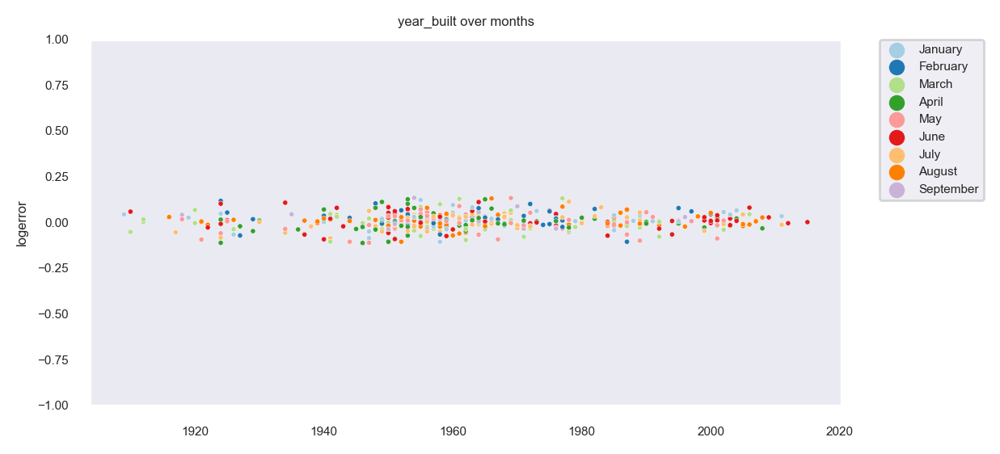

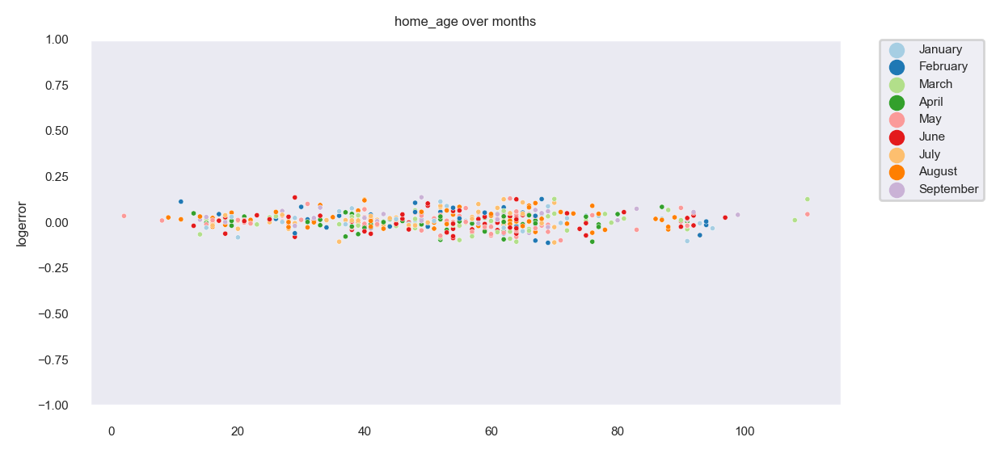

In [45]:
# viewing the log error relationship across continuous features, and transaction months

num_lst = [
    'living_sq_feet',
    'property_sq_feet',
    'home_value',
    'year_built',
    'home_age']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    ax = sns.scatterplot(x = col,
        y = "logerror",
        data = train_imputed.sample(500),
        hue = "transaction_month",
        hue_order = [
            'January',
            'February',
            'March',
            'April',
            'May',
            'June',
            'July',
            'August',
            'September'],
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6'],
        sizes = (20,600),
        s = 5)
    
    # removing scientific notation
    ax.ticklabel_format(style = "plain") 
    

    plt.title(f'{col} over months')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

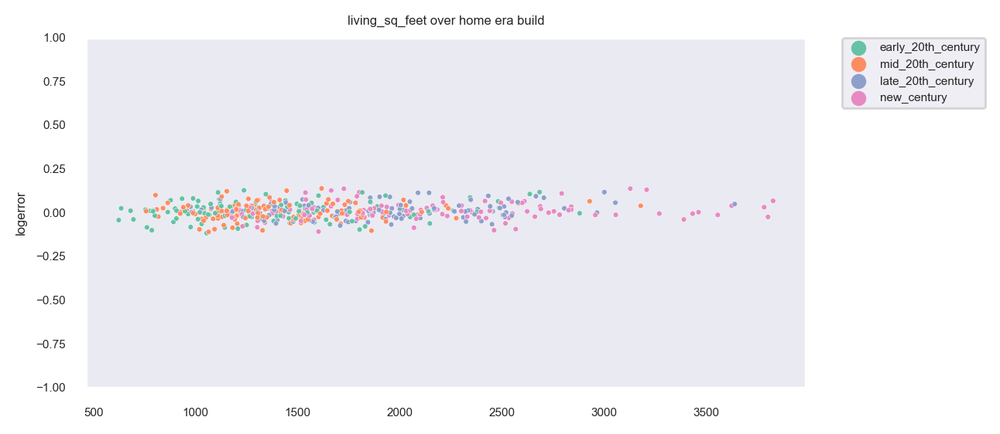

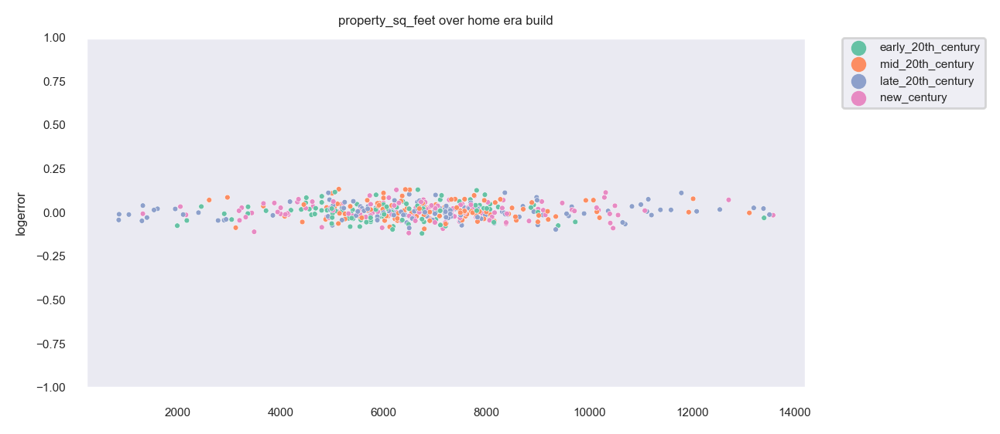

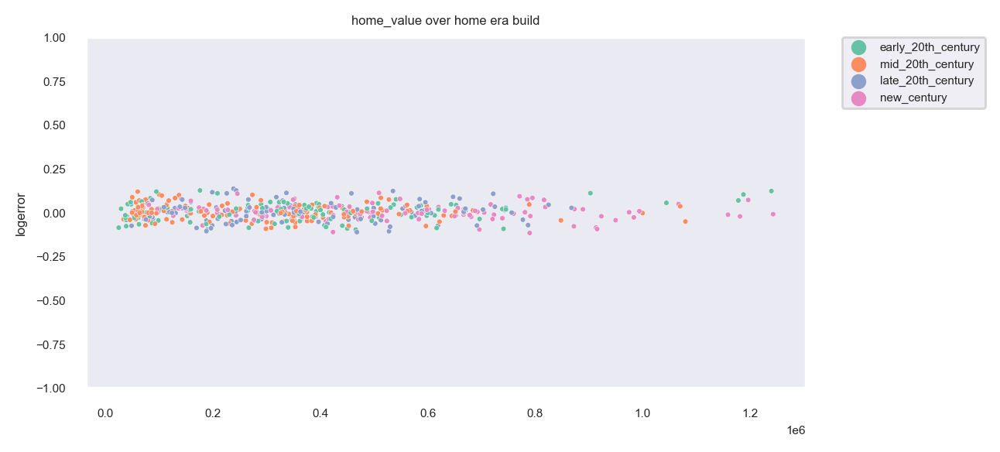

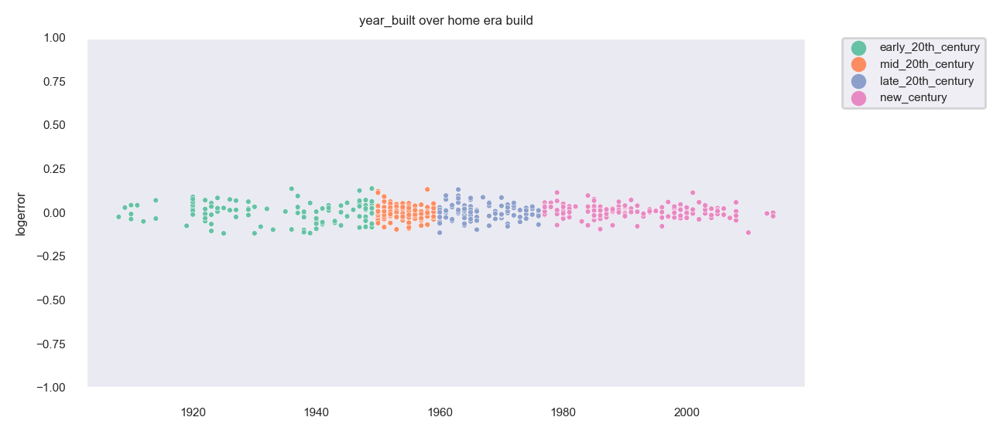

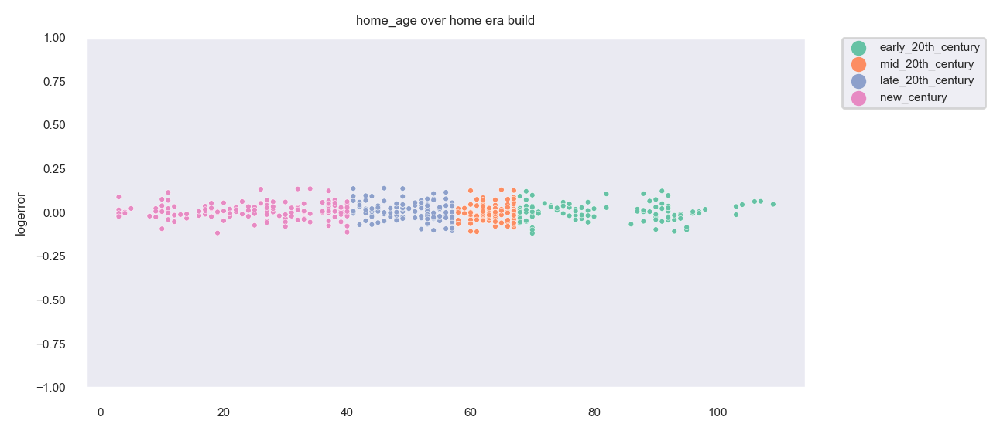

In [46]:
# viewing the log error relationship across continuous features, and home build era

num_lst = [
    'living_sq_feet',
    'property_sq_feet',
    'home_value',
    'year_built',
    'home_age']


for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    sns.scatterplot(x = col,
        y = "logerror",
        data = train_imputed.sample(500),
        hue = "home_age_binned",
        hue_order = ['early_20th_century', 'mid_20th_century', 'late_20th_century', 'new_century'],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3'],
        sizes = (20,600),
        s = 6)

    plt.title(f'{col} over home era build')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

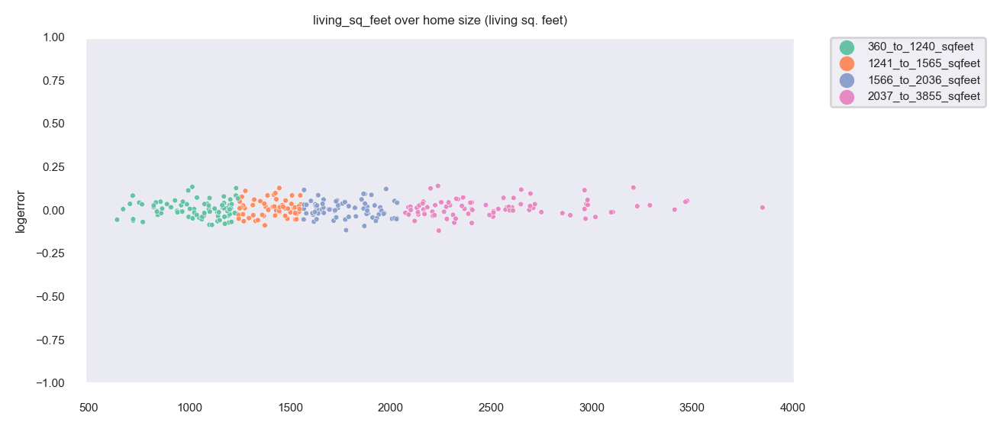

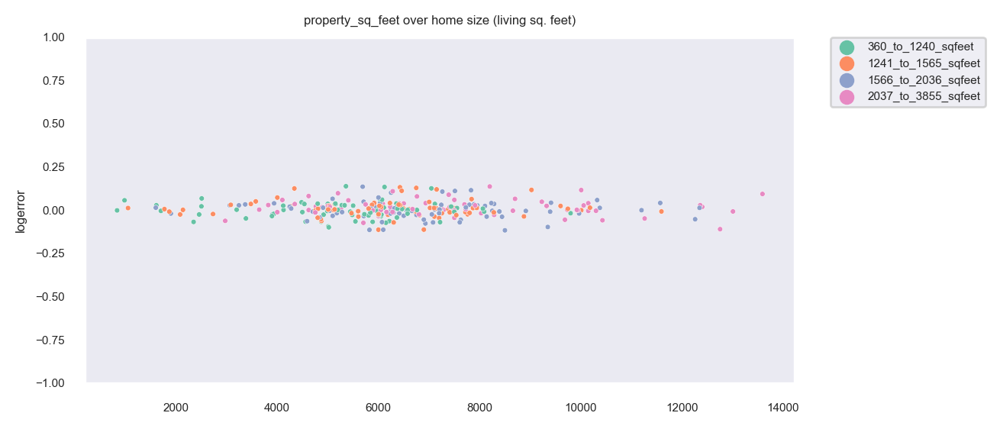

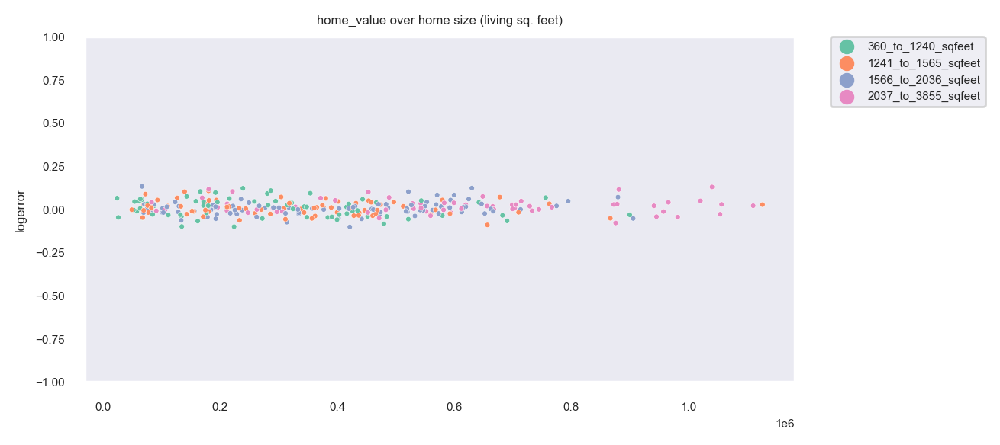

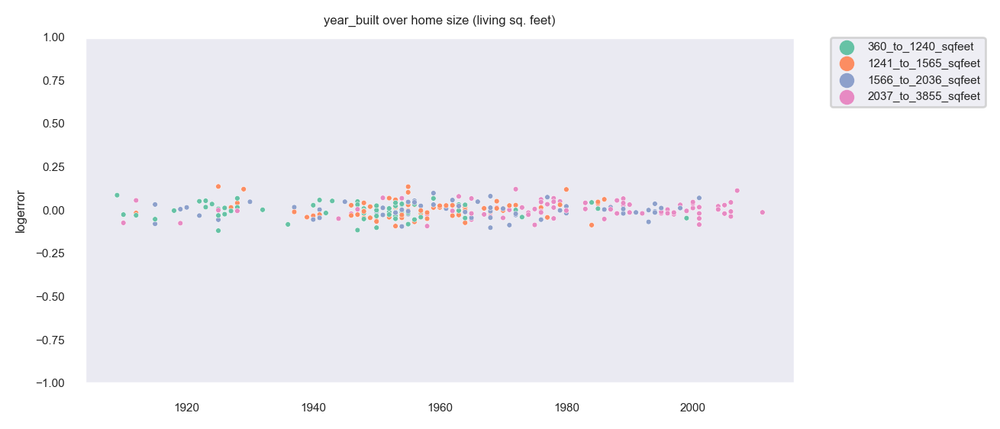

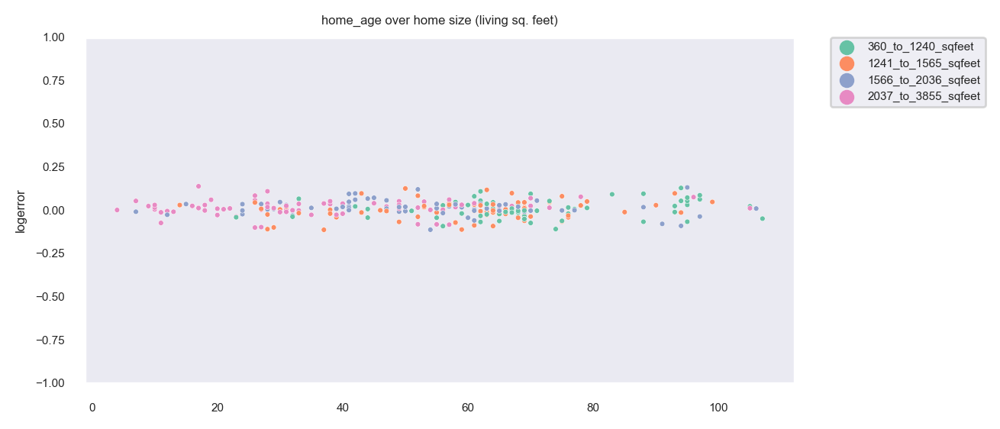

In [47]:
# viewing the log error relationship across continuous features, and home size (living sq. feet)

num_lst = [
    'living_sq_feet',
    'property_sq_feet',
    'home_value',
    'year_built',
    'home_age']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    sns.scatterplot(x = col,
        y = "logerror",
        data = train_imputed.sample(300),
        hue = "living_sqfeet_binned",
        hue_order = ["360_to_1240_sqfeet", "1241_to_1565_sqfeet", "1566_to_2036_sqfeet", "2037_to_3855_sqfeet"],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3'],
        sizes = (20,600),
        s = 6)

    plt.title(f'{col} over home size (living sq. feet)')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

In [48]:
disc_values = list(train_imputed["transaction_quarter"].unique())
disc_values

['q1_transaction', 'q2_transaction', 'q3_transaction']

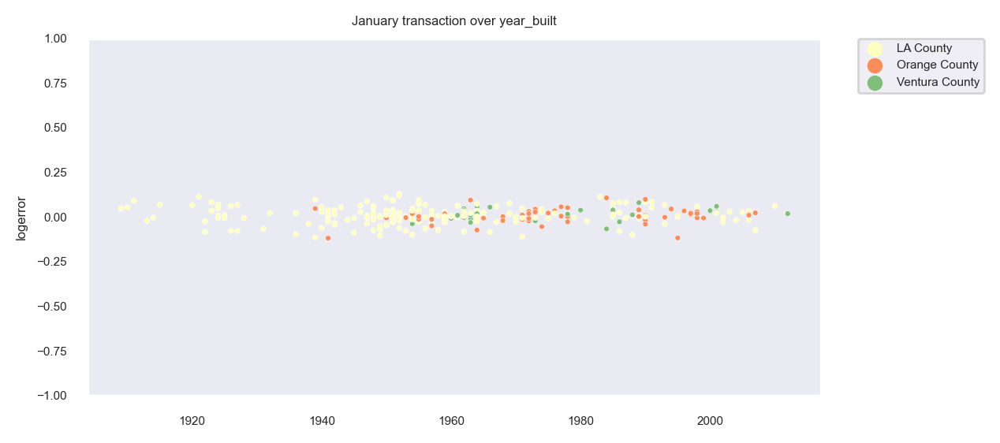

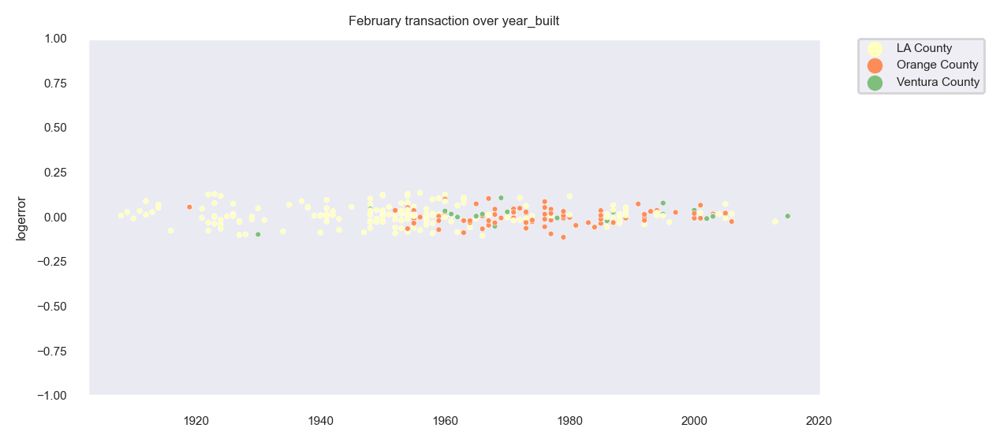

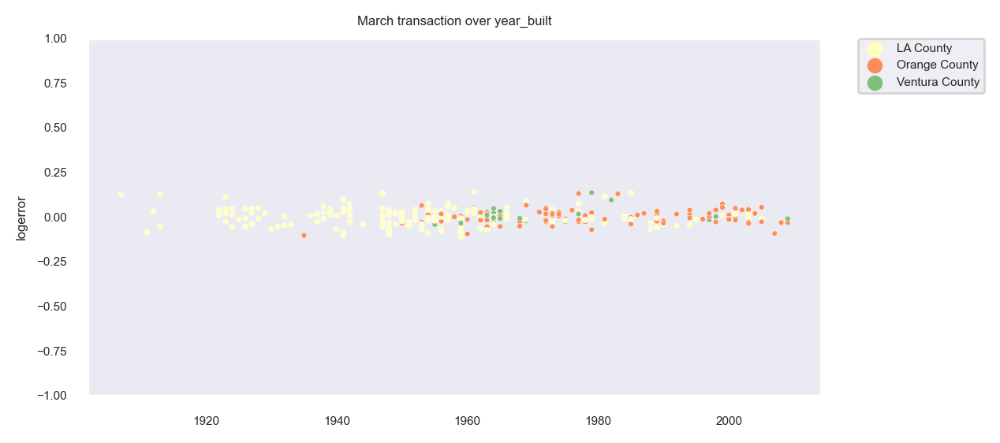

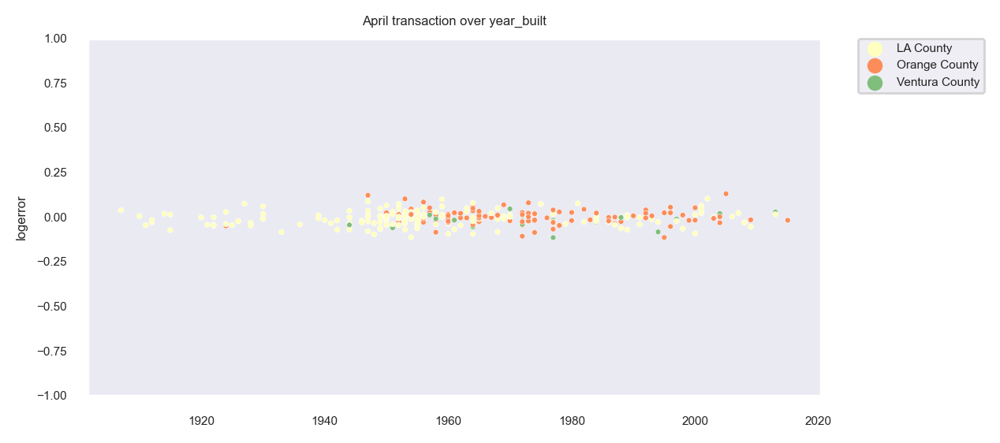

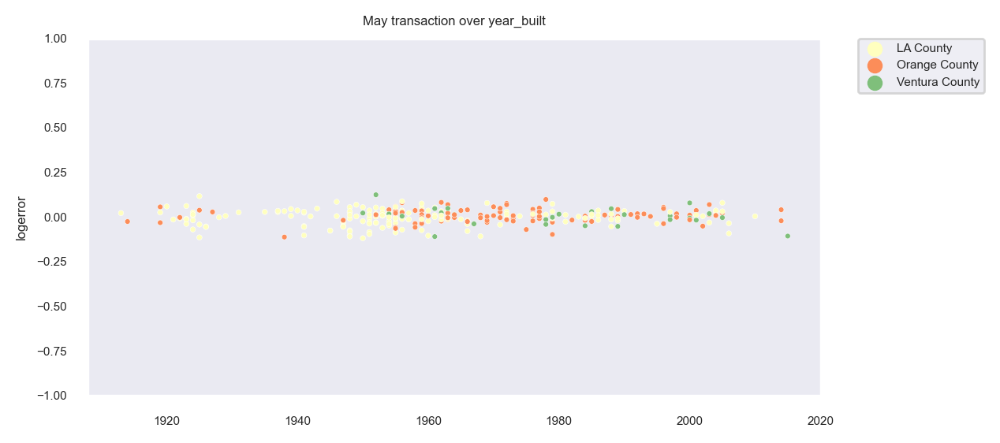

...

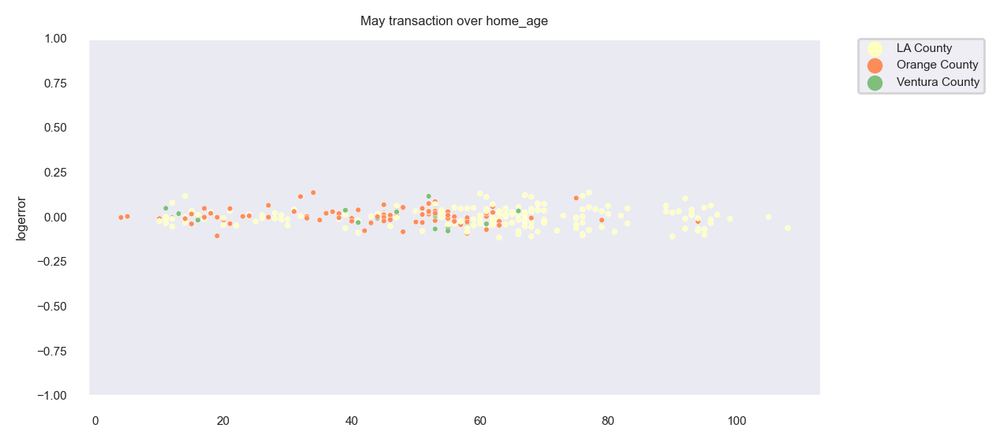

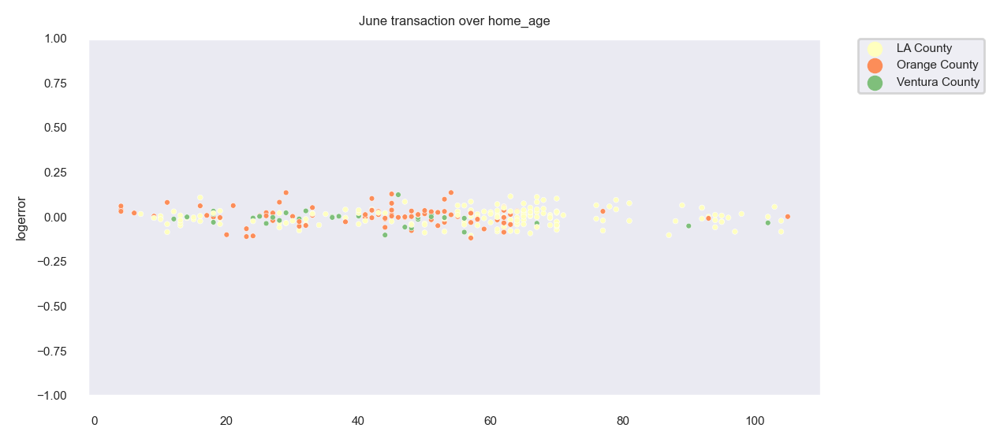

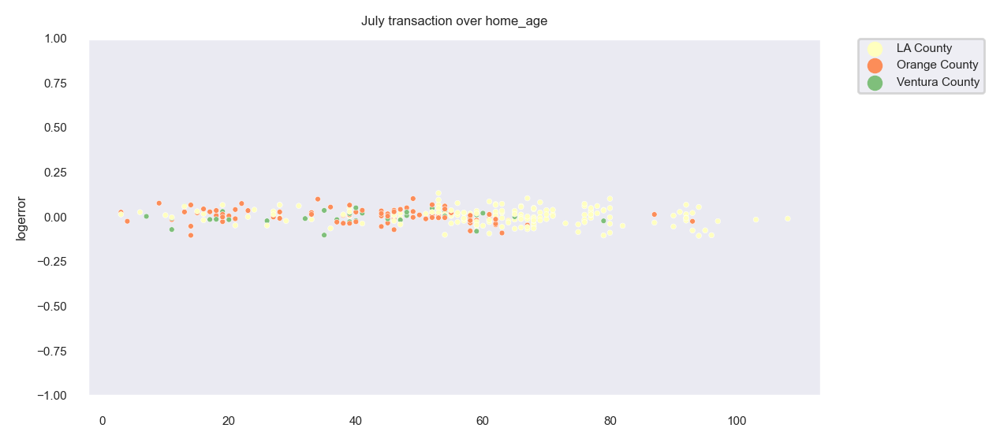

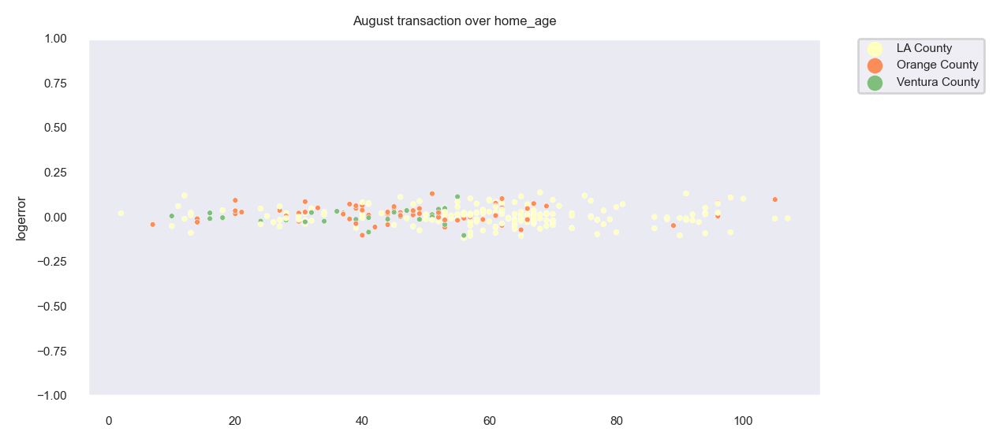

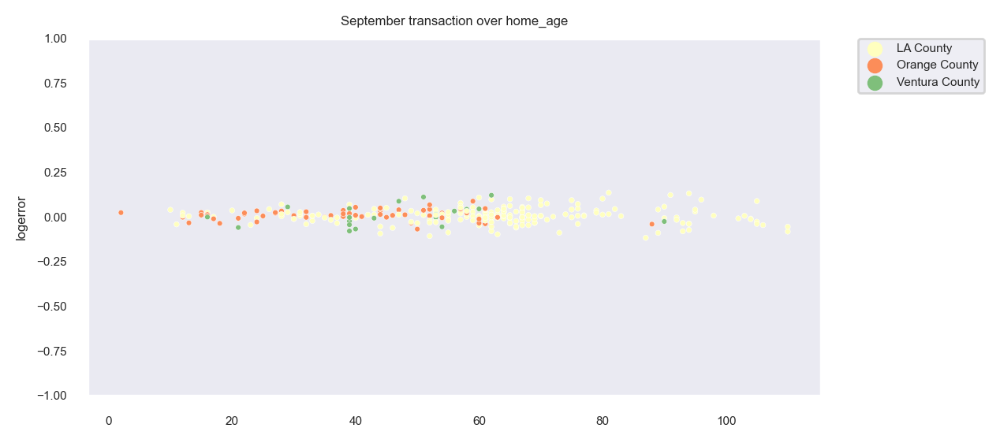

In [49]:
# example 1

num_lst = ['year_built', 'home_age']
disc_values = ['q1_transaction', 'q3_transaction', 'q2_transaction']

months_order = [
            'January',
            'February',
            'March',
            'April',
            'May',
            'June',
            'July',
            'August',
            'September']

for col in num_lst:
 
    for ele in months_order:

        plt.figure(figsize = (6,3))
        sns.set(style = "dark", font_scale = .5)

        df = train_imputed[train_imputed["transaction_month"] == ele]

        sns.scatterplot(x = col,
            y = "logerror",
            data = df.sample(300),
            hue = "county_by_fips",
            hue_order = ["LA County", "Orange County", "Ventura County"],
            palette = ["#ffffbf", "#fc8d59", "#7fbf7b"],
            sizes = (20,600),
            s = 6)

        plt.title(f'{ele} transaction over {col}')
        plt.ylim(-1, 1)
        plt.xlabel(None)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

        plt.show()

------
### ``Question #1: Is there a difference in log error across the three (3) counties?``

<u>**``Conducting ANOVA analysis across examined features``**</u>

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05

In [50]:
# setting the alpha value

confidence_interval = 0.95
alpha = 1 - confidence_interval

County: LA County
logerror: 0.002234313579018921
-------------------------
County: Orange County
logerror: 0.0017445933865604733
-------------------------
County: Ventura County
logerror: 0.0017080676801310697
-------------------------


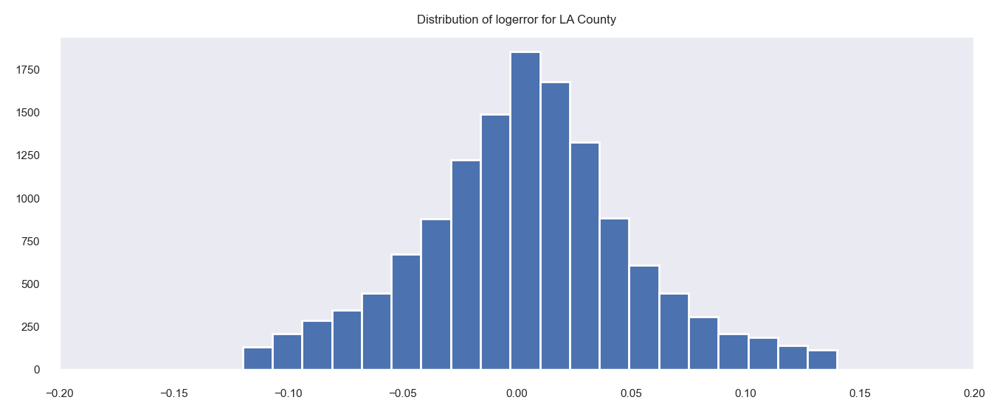

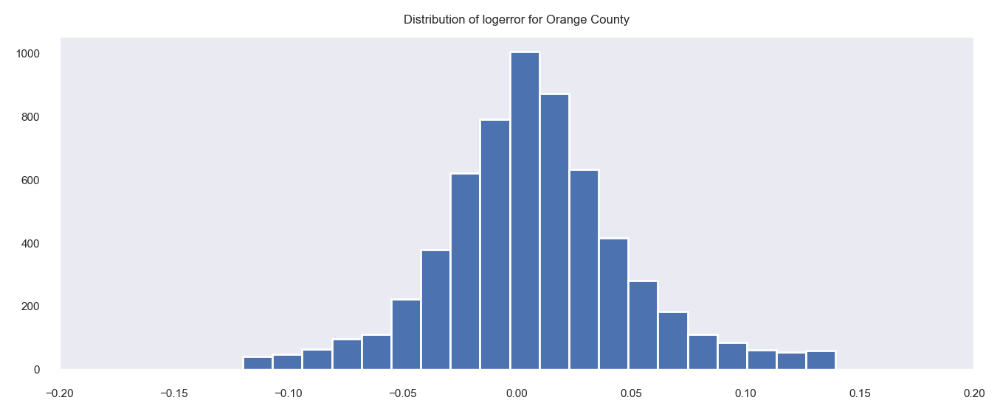

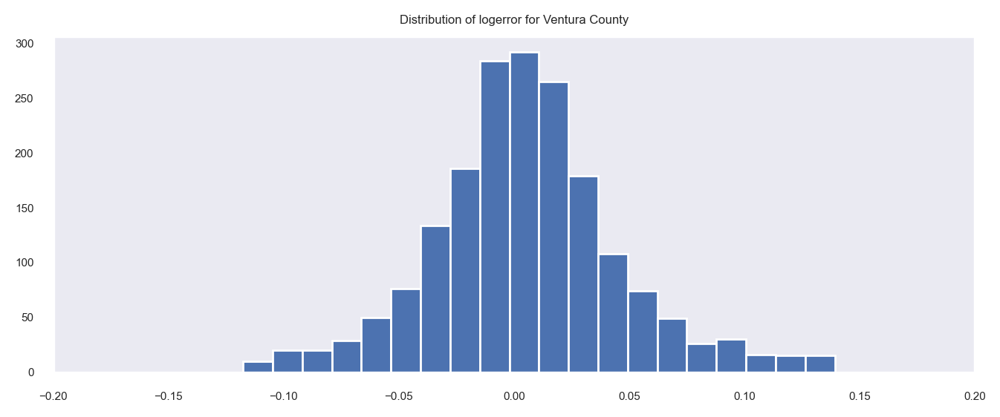

In [51]:
# Question Number #1:
# is there a difference in log error across the three (3) counties?

county_lst = list(train_imputed["county_by_fips"].unique())

for ele in county_lst:
    print(f'County: {ele}')
    print(f'logerror: {train_imputed[train_imputed["county_by_fips"] == ele].logerror.var()}')
    print('-------------------------')

    plt.figure(figsize = (8,3))
    plt.xlim(-.2, .2)

    plt.title('Distribution of logerror for {}'.format(ele))
    plt.hist(train_imputed[train_imputed["county_by_fips"] == ele].logerror, bins = 20)

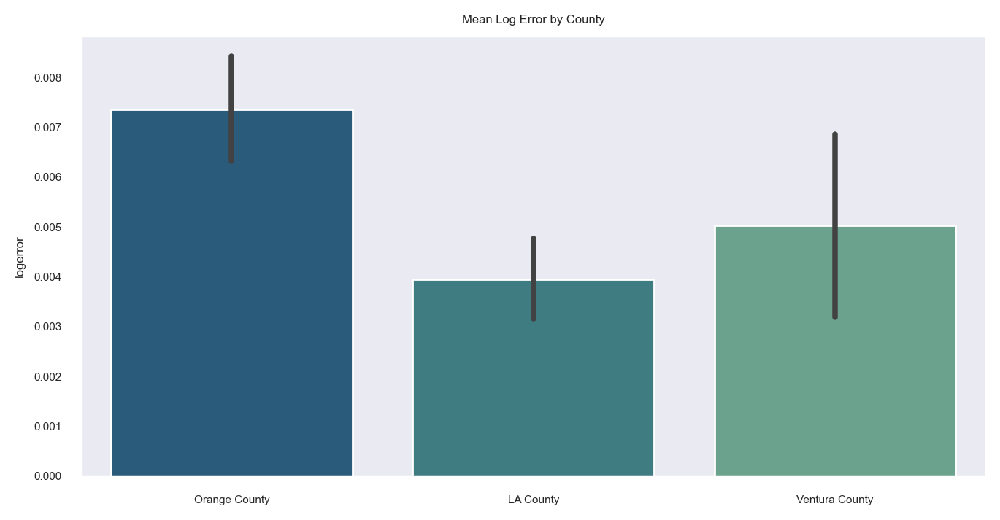

In [52]:
# average log error across counties

plt.figure(figsize = (8, 4))
sns.barplot(
    x = "county_by_fips", 
    y = "logerror", 
    data = train_imputed,
    order = ["Orange County", "LA County", "Ventura County"],
    palette = "crest_r")

plt.title("Mean Log Error by County")
plt.xlabel(None)
plt.show()

In [53]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["county_by_fips"] == "LA County"].logerror,
    train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror,
    train_imputed[train_imputed["county_by_fips"] == "Ventura County"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 79.77943
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [54]:
# ANOVA hypothesis test

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["county_by_fips"] == "LA County"].logerror,
    train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror,
    train_imputed[train_imputed["county_by_fips"] == "Ventura County"].logerror)


# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis.')
else:
    print('We fail to reject the null hypothesis.')

f statistic = 12.02803
p value = 1e-05
-----------------
We reject the null hypothesis.


------
### ``Question #2: Is there a difference in log error across home eras?``

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05

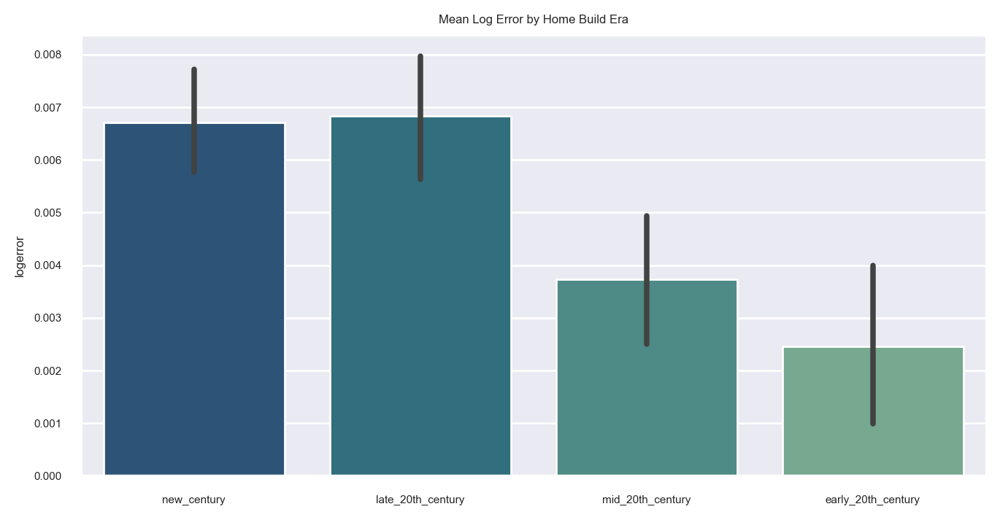

In [55]:
# average log error across home era

plt.figure(figsize = (8, 4))
sns.set(font_scale = 0.5)

sns.barplot(
    x = "home_age_binned", 
    y = "logerror", 
    data = train_imputed,
    palette = "crest_r")

plt.title("Mean Log Error by Home Build Era")
plt.xlabel(None)
plt.show()

In [56]:
# conducting a lavene's test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["home_age_binned"] == "new_century"].logerror,
    train_imputed[train_imputed["home_age_binned"] == "mid_20th_century"].logerror,
    train_imputed[train_imputed["home_age_binned"] == "early_20th_century"].logerror,
    train_imputed[train_imputed["home_age_binned"] == "late_20th_century"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are equal.')

f statistic = 140.26639
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [57]:
# ANOVA hypothesis test for: home era

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["home_age_binned"] == "new_century"].logerror,
    train_imputed[train_imputed["home_age_binned"] == "late_20th_century"].logerror,
    train_imputed[train_imputed["home_age_binned"] == "mid_20th_century"].logerror,
    train_imputed[train_imputed["home_age_binned"] == "early_20th_century"].logerror)


# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 12.12443
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #3: Is there a difference in log error across home era in Orange County?``

**Null Hypothesis:** There's not a logerror variance difference across home eras in Orange County.

**Althernative Hypothesis:** There is a logerror variance difference across home eras in Orange County.

In [58]:
# setting the alpha value

alpha = 0.05

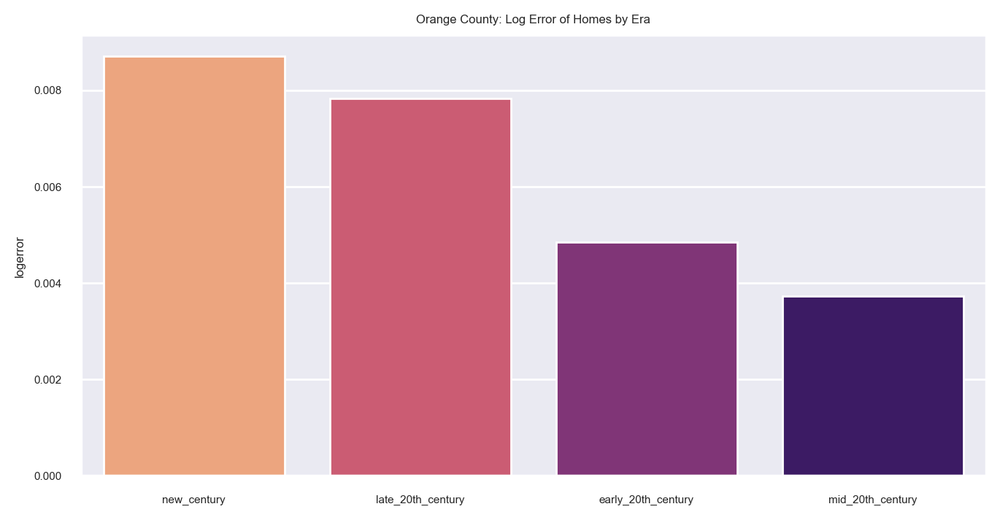

In [59]:
# is there a difference in logerror across orange county and the home build era?

county_lst = list(train_imputed["county_by_fips"].unique())
home_era = list(train_imputed["home_age_binned"].unique())

plt.figure(figsize = (8, 4))
sns.barplot(
    x = "home_age_binned",
    y = train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror,
    data = train_imputed,
    order = ["new_century", "late_20th_century", "early_20th_century", "mid_20th_century"], 
    ci = None,
    palette = "magma_r")

plt.title("Orange County: Log Error of Homes by Era")
plt.xlabel(None)
plt.show()

In [60]:
# conducting levene test to assess variance across build era and orange county

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[(train_imputed["home_age_binned"] == "new_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["home_age_binned"] == "mid_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["home_age_binned"] == "early_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["home_age_binned"] == "late_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 22.33074
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [61]:
# ANOVA hypothesis test for: home era

f_statistic, p_value = stats.f_oneway(
    train_imputed[(train_imputed["home_age_binned"] == "new_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["home_age_binned"] == "mid_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["home_age_binned"] == "early_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["home_age_binned"] == "late_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 3.79526
p value = 0.00986
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #4: Is there a difference in log error across transaction quarter?``

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05

In [62]:
# setting the alpha value

alpha = 0.05

In [63]:
# checking the dataframe

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,59.00,February,mid_20th_century,1241_to_1565_sqfeet,q1_transaction
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,45.00,June,late_20th_century,360_to_1240_sqfeet,q2_transaction
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,26.00,May,new_century,2037_to_3855_sqfeet,q2_transaction
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,67.00,April,mid_20th_century,2037_to_3855_sqfeet,q2_transaction
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,19.00,May,new_century,2037_to_3855_sqfeet,q2_transaction


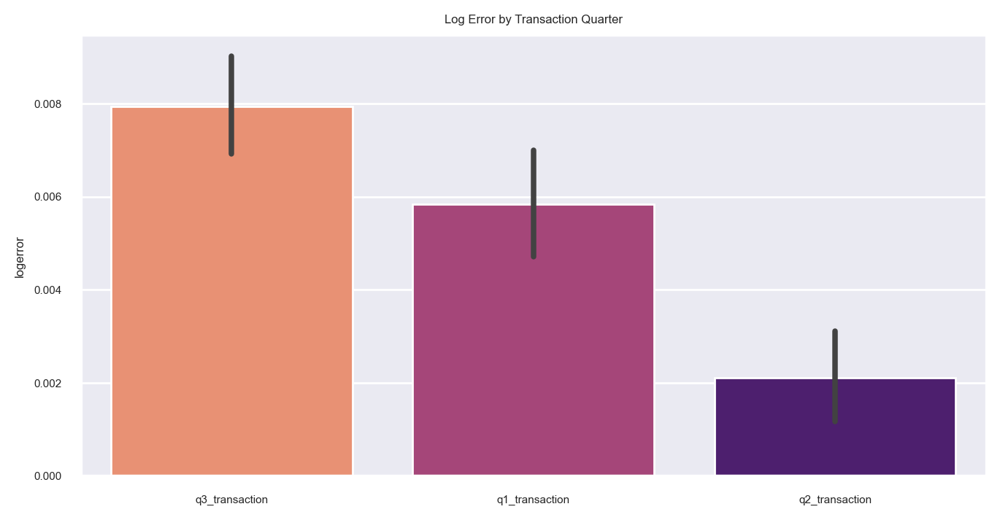

In [64]:
# plotting home transactions by quarters

plt.figure(figsize = (8, 4))
sns.set(font_scale = 0.5)
plt.xlabel(None)

sns.barplot(
    x = "transaction_quarter",
    y = "logerror",
    data = train_imputed,
    order = ["q3_transaction", "q1_transaction", "q2_transaction"], 
    palette = "magma_r")

plt.title("Log Error by Transaction Quarter")
plt.xlabel(None)
plt.show()

In [65]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["transaction_quarter"] == "q1_transaction"].logerror,
    train_imputed[train_imputed["transaction_quarter"] == "q2_transaction"].logerror,
    train_imputed[train_imputed["transaction_quarter"] == "q3_transaction"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 4.78328
p value = 0.00838
-----------------
We reject the null hypothesis. Variances are not equal.


In [66]:
# ANOVA hypothesis test for: transactions by quarter

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["transaction_quarter"] == "q1_transaction"].logerror,
    train_imputed[train_imputed["transaction_quarter"] == "q2_transaction"].logerror,
    train_imputed[train_imputed["transaction_quarter"] == "q3_transaction"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 32.67395
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #5: Is there a difference in log error across transaction month?``

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05 

In [67]:
# let's get a list of all the months

lst_of_months = list(train["transaction_month"].unique())
lst_of_months # checks out!

['February',
 'June',
 'May',
 'April',
 'July',
 'September',
 'January',
 'August',
 'March']

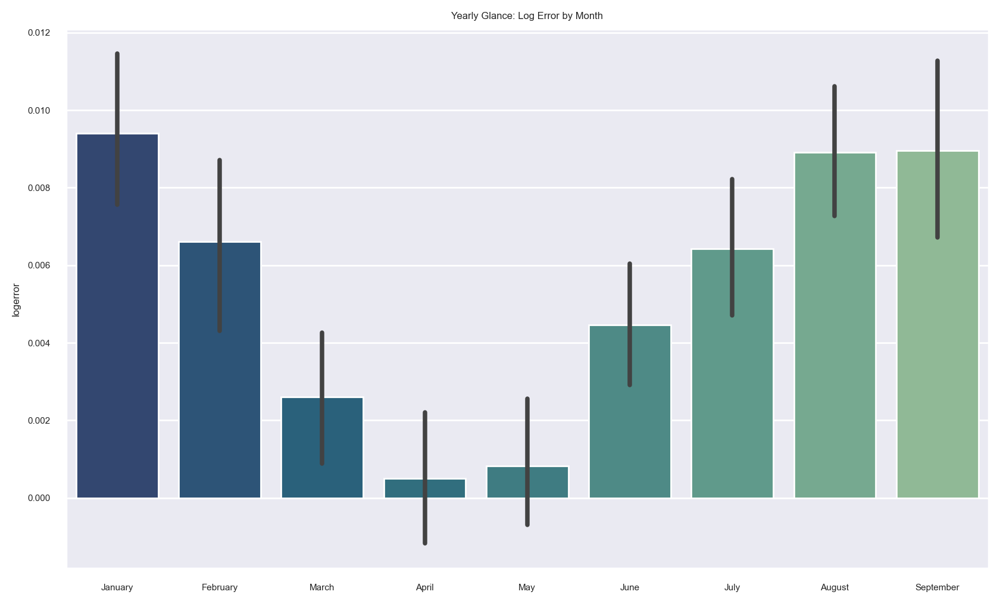

In [68]:
# plotting log error for all months

plt.figure(figsize = (10, 6))
sns.barplot(x = "transaction_month",
    y = "logerror", 
    data = train_imputed,
    order = [
    'January',
    'February',
    'March',
    'April',
    'May',
    'June',
    'July',
    'August',
    'September'],
    palette = "crest_r",
    ci = 95)

plt.title("Yearly Glance: Log Error by Month")
plt.xlabel(None)
plt.show()

In [69]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["transaction_month"] == "January"].logerror,
    train_imputed[train_imputed["transaction_month"] == "February"].logerror,
    train_imputed[train_imputed["transaction_month"] == "March"].logerror,
    train_imputed[train_imputed["transaction_month"] == "April"].logerror,
    train_imputed[train_imputed["transaction_month"] == "May"].logerror,
    train_imputed[train_imputed["transaction_month"] == "June"].logerror,
    train_imputed[train_imputed["transaction_month"] == "July"].logerror,
    train_imputed[train_imputed["transaction_month"] == "August"].logerror,
    train_imputed[train_imputed["transaction_month"] == "September"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 1.63649
p value = 0.1088
-----------------
We fail to reject the null hypothesis. Variances are relatively equal.


In [70]:
# ANOVA hypothesis test for: transactions by quarter

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["transaction_month"] == "January"].logerror,
    train_imputed[train_imputed["transaction_month"] == "February"].logerror,
    train_imputed[train_imputed["transaction_month"] == "March"].logerror,
    train_imputed[train_imputed["transaction_month"] == "April"].logerror,
    train_imputed[train_imputed["transaction_month"] == "May"].logerror,
    train_imputed[train_imputed["transaction_month"] == "June"].logerror,
    train_imputed[train_imputed["transaction_month"] == "July"].logerror,
    train_imputed[train_imputed["transaction_month"] == "August"].logerror,
    train_imputed[train_imputed["transaction_month"] == "September"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 13.7715
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #6: Is there a difference across home transaction months in Orange County?``

**Null Hypothesis:** There's not a logerror variance difference across transaction months in Orange County.

**Althernative Hypothesis:** There is a logerror variance difference across transaction months in Orange County.

$\alpha$: 0.05

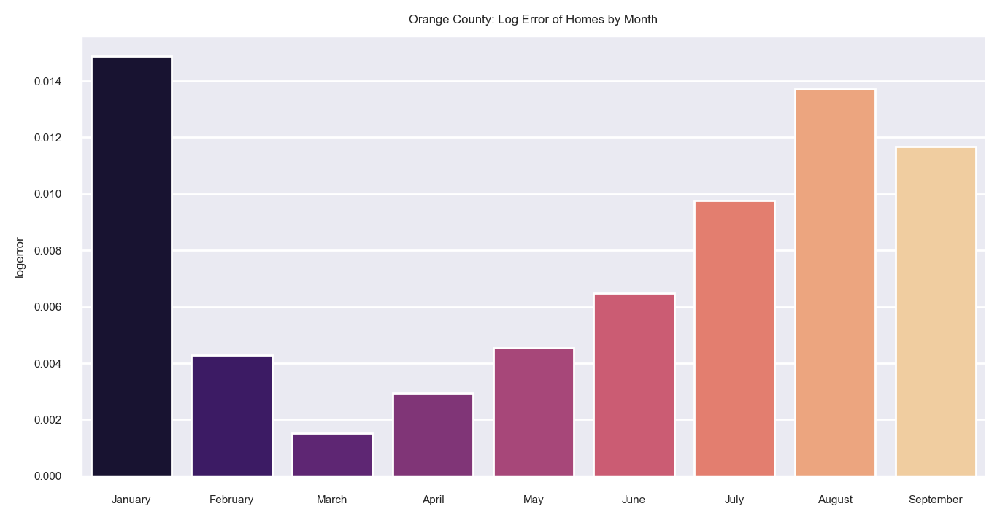

In [71]:
county_lst = list(train_imputed["county_by_fips"].unique())
home_era = list(train_imputed["home_age_binned"].unique())

plt.figure(figsize = (8, 4))
sns.barplot(
    x = "transaction_month",
    y = train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror,
    data = train_imputed, 
    ci = None,
    order = [
    'January',
    'February',
    'March',
    'April',
    'May',
    'June',
    'July',
    'August',
    'September'],
    palette = "magma")

plt.title("Orange County: Log Error of Homes by Month")
plt.xlabel(None)
plt.show()

In [72]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[(train_imputed["transaction_month"] == "January") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "February") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "March")& (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "April") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "May") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "June") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "July") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "August") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "September") & (train_imputed["county_by_fips"] == "Orange County")].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 1.26117
p value = 0.25904
-----------------
We fail to reject the null hypothesis. Variances are relatively equal.


In [73]:
# ANOVA hypothesis test for: transactions by quarter in Orange County

f_statistic, p_value = stats.f_oneway(
   train_imputed[(train_imputed["transaction_month"] == "January") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "February") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "March")& (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "April") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "May") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "June") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "July") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "August") & (train_imputed["county_by_fips"] == "Orange County")].logerror,
    train_imputed[(train_imputed["transaction_month"] == "September") & (train_imputed["county_by_fips"] == "Orange County")].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 8.88499
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #7: Is there a difference in log error across grouped home sizes (binned sq-feet)?``

**Null Hypothesis:** There's not a logerror variance difference across group home sizes.

**Althernative Hypothesis:** There is a logerror variance difference across group home sizes.

$\alpha$: 0.05

In [74]:
size_lst = list(train_imputed["living_sqfeet_binned"].unique().sort_values())
size_lst

['360_to_1240_sqfeet',
 '1241_to_1565_sqfeet',
 '1566_to_2036_sqfeet',
 '2037_to_3855_sqfeet']

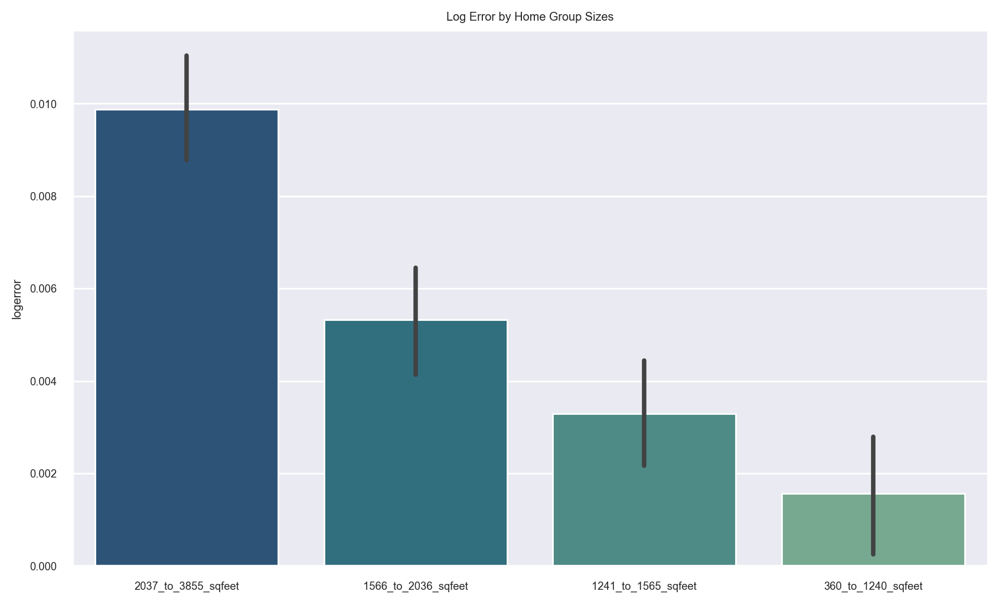

In [75]:
# creating a for loop to bar plot log error for all months

plt.figure(figsize = (10, 6))
sns.set(font_scale = 0.6)
sns.barplot(x = "living_sqfeet_binned",
    y = "logerror", 
    data = train_imputed,
    order = [
        "2037_to_3855_sqfeet", 
        "1566_to_2036_sqfeet", 
        "1241_to_1565_sqfeet",
        "360_to_1240_sqfeet"],
    palette = "crest_r",
    ci = 95)

plt.title("Log Error by Home Group Sizes")
plt.xlabel(None)
plt.show()

In [76]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["living_sqfeet_binned"] == "360_to_1240_sqfeet"].logerror,
    train_imputed[train_imputed["living_sqfeet_binned"] == "1241_to_1565_sqfeet"].logerror,
    train_imputed[train_imputed["living_sqfeet_binned"] == "1566_to_2036_sqfeet"].logerror,
    train_imputed[train_imputed["living_sqfeet_binned"] == "2037_to_3855_sqfeet"].logerror)


# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 29.79513
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [77]:
# ANOVA hypothesis test for: home size groups

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["living_sqfeet_binned"] == "360_to_1240_sqfeet"].logerror,
    train_imputed[train_imputed["living_sqfeet_binned"] == "1241_to_1565_sqfeet"].logerror,
    train_imputed[train_imputed["living_sqfeet_binned"] == "1566_to_2036_sqfeet"].logerror,
    train_imputed[train_imputed["living_sqfeet_binned"] == "2037_to_3855_sqfeet"].logerror)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 33.85687
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Hypothesis Testing on Independent Features:``

In [78]:
# checking the df head 

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter
6446,11013745,102253.00,-0.07,2.00,4.00,1518.00,LA County,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,59.00,February,mid_20th_century,1241_to_1565_sqfeet,q1_transaction
34431,14174225,452706.00,0.04,2.00,1.00,1221.00,Orange County,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,45.00,June,late_20th_century,360_to_1240_sqfeet,q2_transaction
22887,14275774,425084.00,-0.02,3.50,4.00,2982.00,Orange County,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,26.00,May,new_century,2037_to_3855_sqfeet,q2_transaction
20139,10955293,143359.00,0.01,3.00,4.00,2446.00,LA County,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,67.00,April,mid_20th_century,2037_to_3855_sqfeet,q2_transaction
22438,14140584,976000.00,0.07,4.50,5.00,2933.00,Orange County,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,19.00,May,new_century,2037_to_3855_sqfeet,q2_transaction


In [79]:
col_lst = train_imputed.columns.tolist()
col_lst

['parcel_id',
 'home_value',
 'logerror',
 'bathroom_count',
 'bedroom_count',
 'living_sq_feet',
 'county_by_fips',
 'latitude',
 'longitude',
 'property_sq_feet',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built',
 'home_age',
 'transaction_month',
 'home_age_binned',
 'living_sqfeet_binned',
 'transaction_quarter']

In [80]:
# let's generate dummy variables for the following and scale our data

# transaction month
# home age binned
# living sq feet binned
# transaction quarters

# train dataset
train_dummy = pd.get_dummies(data = train_imputed, columns = [
    'transaction_month', 
    'home_age_binned',
    'bathroom_count',
    'bedroom_count',
    'county_by_fips',
    'living_sqfeet_binned',
    'transaction_quarter'],
    drop_first = False, 
    dtype = bool)

# validate dataset
validate_dummy = pd.get_dummies(data = validate_imputed, columns = [
    'transaction_month', 
    'home_age_binned',
    'bathroom_count',
    'bedroom_count',
    'county_by_fips',
    'living_sqfeet_binned',
    'transaction_quarter'],
    drop_first = False, 
    dtype = bool)

# test dataset
test_dummy = pd.get_dummies(data = test_imputed, columns = [
    'transaction_month', 
    'home_age_binned',
    'bathroom_count',
    'bedroom_count',
    'county_by_fips',
    'living_sqfeet_binned',
    'transaction_quarter'],
    drop_first = False, 
    dtype = bool)

# checking the train dataset
train_dummy.head()

,parcel_id,home_value,logerror,living_sq_feet,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,...,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,living_sqfeet_binned_360_to_1240_sqfeet,living_sqfeet_binned_1241_to_1565_sqfeet,living_sqfeet_binned_1566_to_2036_sqfeet,living_sqfeet_binned_2037_to_3855_sqfeet,transaction_quarter_q1_transaction,transaction_quarter_q2_transaction,transaction_quarter_q3_transaction
6446,11013745,102253.00,-0.07,1518.00,34287537.00,-118505758.00,11243.00,0101,60371066.42,1958.00,...,True,False,False,False,True,False,False,True,False,False
34431,14174225,452706.00,0.04,1221.00,33908240.00,-117876059.00,2800.00,122,60590117.07,1972.00,...,False,True,False,True,False,False,False,False,True,False
22887,14275774,425084.00,-0.02,2982.00,33614051.00,-117918041.00,3520.00,122,60590629.00,1991.00,...,False,True,False,False,False,False,True,False,True,False
20139,10955293,143359.00,0.01,2446.00,34209946.00,-118338719.00,6707.00,0101,60373101.00,1950.00,...,True,False,False,False,False,False,True,False,True,False
22438,14140584,976000.00,0.07,2933.00,33898686.00,-117907151.00,5260.00,122,60590016.02,1998.00,...,False,True,False,False,False,False,True,False,True,False


In [81]:
#column dtypes

train_dummy.dtypes.sort_values(ascending = False)

parcel_id                                    object
county_zoning_code                           object
property_sq_feet                            float64
home_value                                  float64
home_age                                    float64
blockgroup_assignment                       float64
year_built                                  float64
longitude                                   float64
latitude                                    float64
living_sq_feet                              float64
logerror                                    float64
county_by_fips_LA County                       bool
bathroom_count_4.5                             bool
bedroom_count_1.0                              bool
bedroom_count_2.0                              bool
bedroom_count_3.0                              bool
bedroom_count_4.0                              bool
bedroom_count_5.0                              bool
living_sqfeet_binned_1566_to_2036_sqfeet       bool
county_by_fi

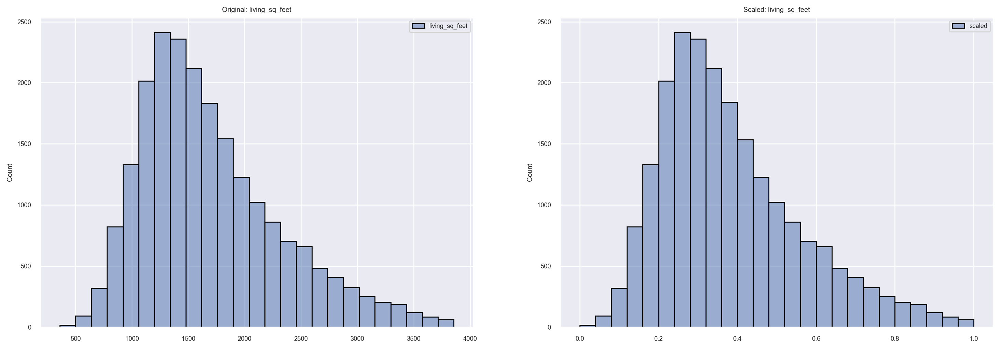

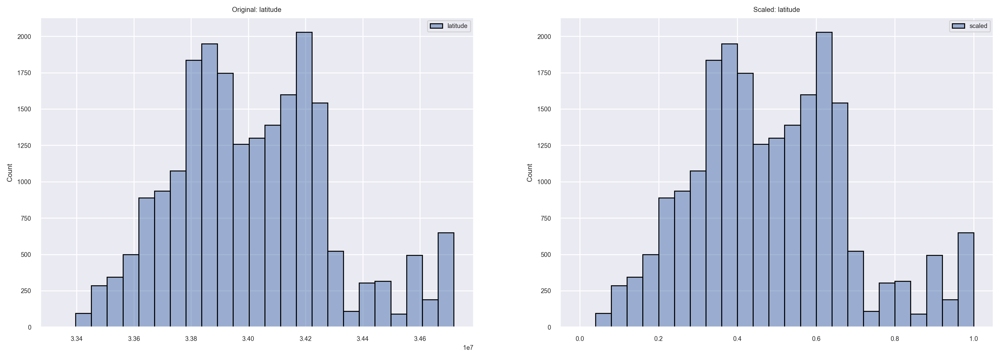

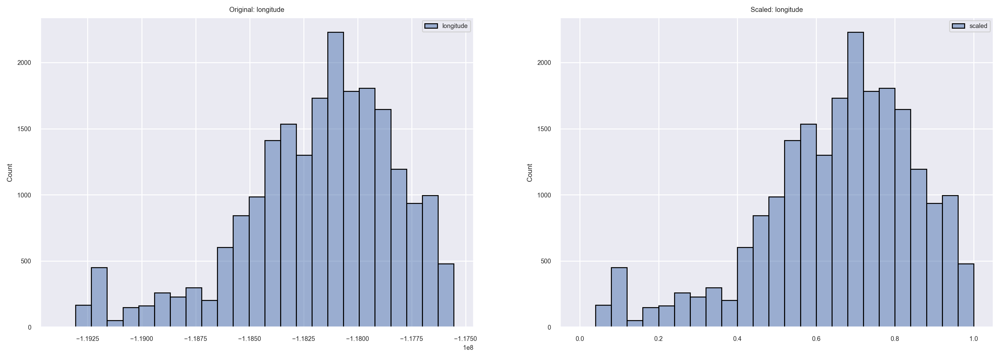

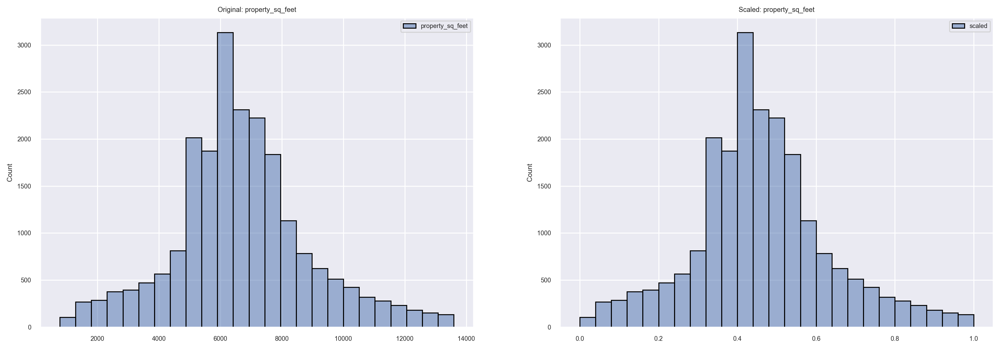

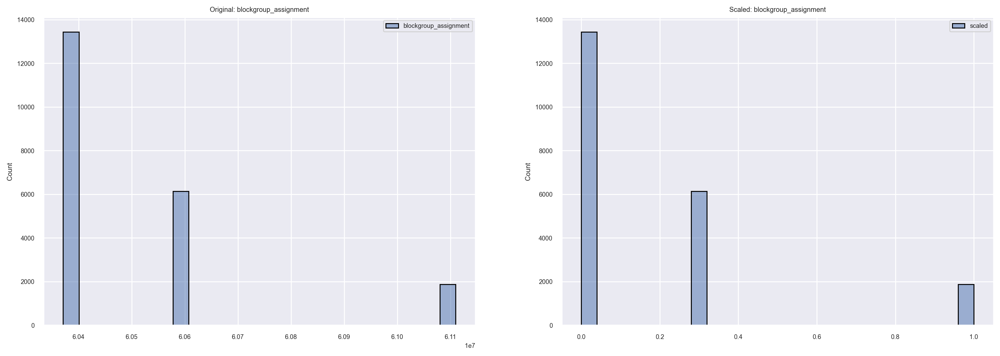

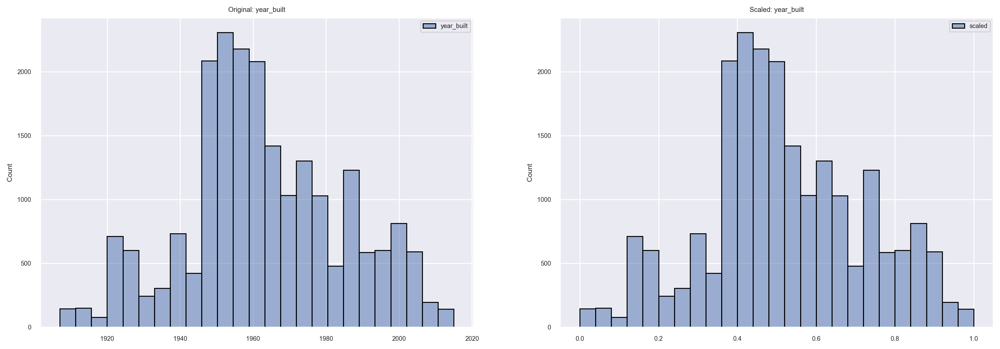

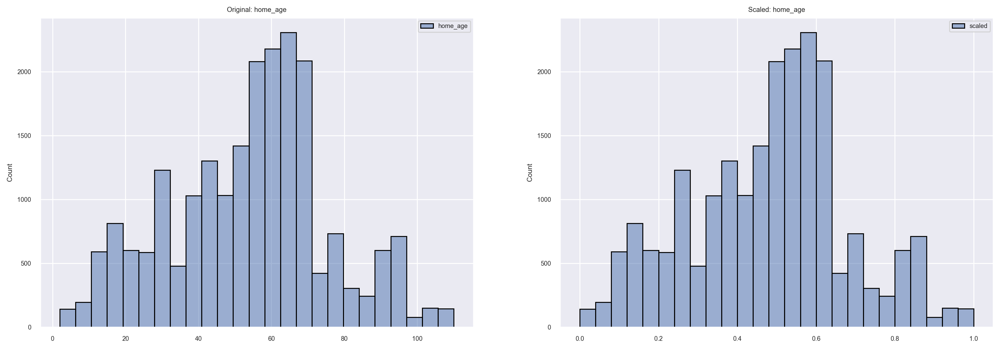

In [82]:
cont_lst = train_dummy.select_dtypes(exclude = ["object", "category", "uint8", "int64", "bool"]).columns.tolist()
cont_lst = [ele for ele in cont_lst if ele not in ("logerror", "home_value")]

for col in cont_lst:
    scaler = MinMaxScaler()
    scaler.fit(train_dummy[[col]])

    x_scaled = scaler.transform(train_dummy[[col]])

    plt.figure(figsize=(18, 6))
    plt.subplot(121)
    sns.histplot(train_dummy[[col]], bins = 25, edgecolor = 'black', label = col)
    
    plt.title(f'Original: {col}')
    plt.legend()

    plt.subplot(122)
    ax = sns.histplot(x_scaled, bins=25, edgecolor = 'black', label = "scaled")
    
    # removing axes scientific notation 
    ax.ticklabel_format(style = "plain") 
    plt.title(f'Scaled: {col}')
    plt.legend()

In [83]:
# scaling necessary features in datasets

scaler = MinMaxScaler()
scaler.fit(train_dummy[cont_lst])

# dummy datasets
train_dummy[cont_lst] = scaler.transform(train_dummy[cont_lst])
validate_dummy[cont_lst] = scaler.transform(validate_dummy[cont_lst])
test_dummy[cont_lst] = scaler.transform(test_dummy[cont_lst])

# non-dummy datasets
train_imputed[cont_lst] = scaler.transform(train_imputed[cont_lst])
validate_imputed[cont_lst] = scaler.transform(validate_imputed[cont_lst])
test_imputed[cont_lst] = scaler.transform(test_imputed[cont_lst])

In [84]:
# let's check the scaler worked

train_dummy.head() # checks out!

,parcel_id,home_value,logerror,living_sq_feet,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,...,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,living_sqfeet_binned_360_to_1240_sqfeet,living_sqfeet_binned_1241_to_1565_sqfeet,living_sqfeet_binned_1566_to_2036_sqfeet,living_sqfeet_binned_2037_to_3855_sqfeet,transaction_quarter_q1_transaction,transaction_quarter_q2_transaction,transaction_quarter_q3_transaction
6446,11013745,102253.00,-0.07,0.33,0.69,0.48,0.82,0101,0.00,0.47,...,True,False,False,False,True,False,False,True,False,False
34431,14174225,452706.00,0.04,0.25,0.41,0.82,0.16,122,0.30,0.60,...,False,True,False,True,False,False,False,False,True,False
22887,14275774,425084.00,-0.02,0.75,0.20,0.80,0.21,122,0.30,0.78,...,False,True,False,False,False,False,True,False,True,False
20139,10955293,143359.00,0.01,0.60,0.63,0.57,0.46,0101,0.00,0.40,...,True,False,False,False,False,False,True,False,True,False
22438,14140584,976000.00,0.07,0.74,0.40,0.81,0.35,122,0.30,0.84,...,False,True,False,False,False,False,True,False,True,False


In [85]:
# training dataset columns

train_dummy.columns.tolist()

['parcel_id',
 'home_value',
 'logerror',
 'living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built',
 'home_age',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_1.0',
 'bathroom_count_1.5',
 'bathroom_count_2.0',
 'bathroom_count_2.5',
 'bathroom_count_3.0',
 'bathroom_count_3.5',
 'bathroom_count_4.0',
 'bathroom_count_4.5',
 'bedroom_count_1.0',
 'bedroom_count_2.0',
 'bedroom_count_3.0',
 'bedroom_count_4.0',
 'bedroom_count_5.0',
 'county_by_fips_LA County',
 'county_by_fips_Orange County',
 'county_by_fips_Ventura County',
 'living_sqfeet_binn

In [86]:
disc_lst = train_dummy.select_dtypes(exclude = "number").columns.tolist()
disc_lst

['parcel_id',
 'county_zoning_code',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_1.0',
 'bathroom_count_1.5',
 'bathroom_count_2.0',
 'bathroom_count_2.5',
 'bathroom_count_3.0',
 'bathroom_count_3.5',
 'bathroom_count_4.0',
 'bathroom_count_4.5',
 'bedroom_count_1.0',
 'bedroom_count_2.0',
 'bedroom_count_3.0',
 'bedroom_count_4.0',
 'bedroom_count_5.0',
 'county_by_fips_LA County',
 'county_by_fips_Orange County',
 'county_by_fips_Ventura County',
 'living_sqfeet_binned_360_to_1240_sqfeet',
 'living_sqfeet_binned_1241_to_1565_sqfeet',
 'living_sqfeet_binned_1566_to_2036_sqfeet',
 'living_sqfeet_binned_2037_to_3855

In [87]:
# setting features to cluster on 

X_month = train_dummy[[
    'home_age',
    'transaction_month_January',
    'transaction_month_February',
    'transaction_month_March',
    'transaction_month_April',
    'transaction_month_May',
    'transaction_month_June',
    'transaction_month_July',
    'transaction_month_August',
    'transaction_month_September'
    ]]

# val df
X_val = validate_dummy[[
    'home_age',
    'transaction_month_January',
    'transaction_month_February',
    'transaction_month_March',
    'transaction_month_April',
    'transaction_month_May',
    'transaction_month_June',
    'transaction_month_July',
    'transaction_month_August',
    'transaction_month_September'
    ]]

# test df
X_test = test_dummy[[
    'home_age',
    'transaction_month_January',
    'transaction_month_February',
    'transaction_month_March',
    'transaction_month_April',
    'transaction_month_May',
    'transaction_month_June',
    'transaction_month_July',
    'transaction_month_August',
    'transaction_month_September'
    ]]

X_month.head()

,home_age,transaction_month_January,transaction_month_February,transaction_month_March,transaction_month_April,transaction_month_May,transaction_month_June,transaction_month_July,transaction_month_August,transaction_month_September
6446,0.53,False,True,False,False,False,False,False,False,False
34431,0.40,False,False,False,False,False,True,False,False,False
22887,0.22,False,False,False,False,True,False,False,False,False
20139,0.60,False,False,False,True,False,False,False,False,False
22438,0.16,False,False,False,False,True,False,False,False,False


In [88]:
# initial fitting of KMeans cluster

kmeans = KMeans(n_clusters = 9)
kmeans.fit(X_month)

train_clusters = kmeans.predict(X_month)

train_clusters

array([7, 1, 3, ..., 2, 2, 6], dtype=int32)

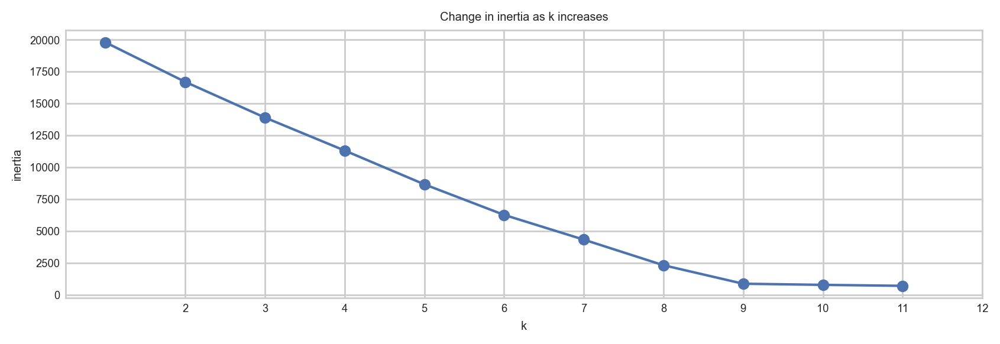

In [89]:
with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k).fit(X_month).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

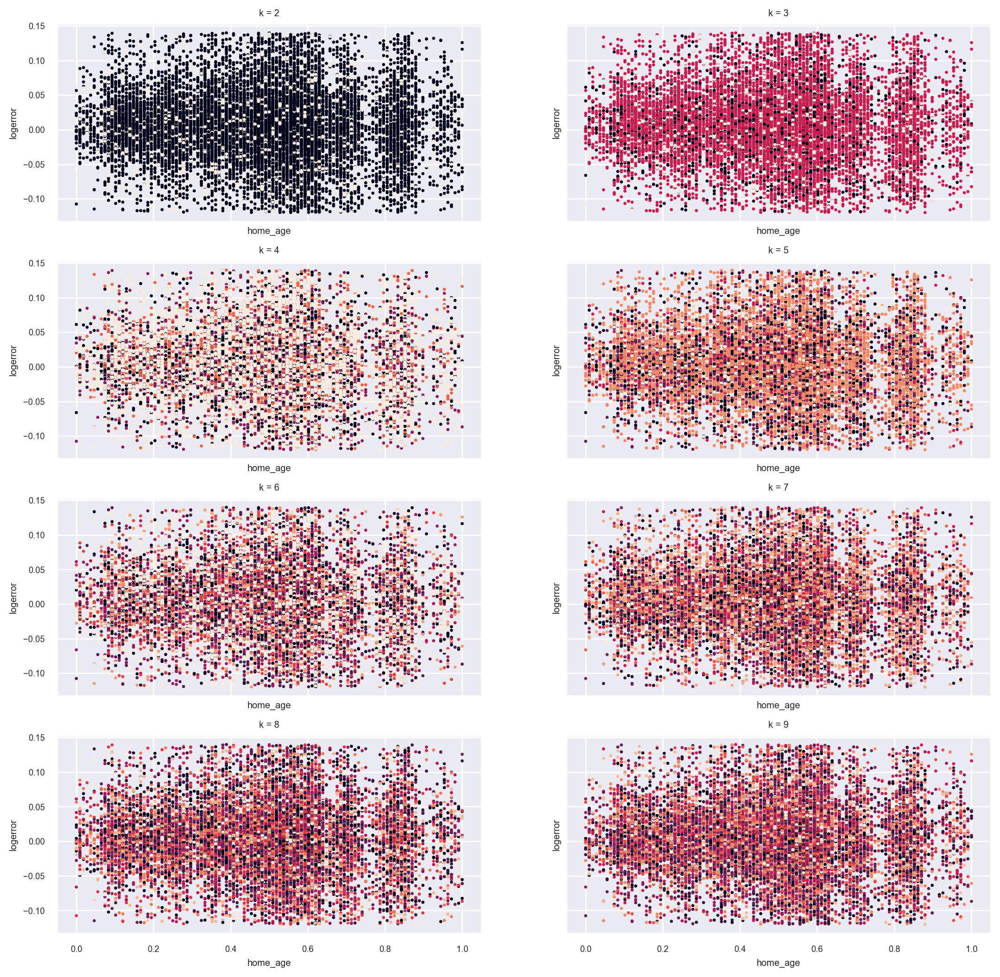

In [90]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 13)):
    
    # creating and fitting KMeans
    clusters = KMeans(k).fit(X_month).predict(X_month)

    X_month["logerror"] = train_dummy["logerror"]

    ax.scatter(
        X_month["home_age"], 
        X_month["logerror"], 
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'home_age', ylabel = 'logerror')

In [91]:
# cleaning target in KMeans cluster and creating val and test clusters

X_month = X_month.drop(columns = "logerror")

kmeans = KMeans(n_clusters = 9)
kmeans.fit(X_month)

train_age_clusters = kmeans.predict(X_month)
val_age_clusters = kmeans.predict(X_val)
test_age_clusters = kmeans.predict(X_test)

train_age_clusters

array([7, 1, 2, ..., 4, 4, 6], dtype=int32)

In [92]:
# checking for cleaning

X_month.head()

,home_age,transaction_month_January,transaction_month_February,transaction_month_March,transaction_month_April,transaction_month_May,transaction_month_June,transaction_month_July,transaction_month_August,transaction_month_September
6446,0.53,False,True,False,False,False,False,False,False,False
34431,0.40,False,False,False,False,False,True,False,False,False
22887,0.22,False,False,False,False,True,False,False,False,False
20139,0.60,False,False,False,True,False,False,False,False,False
22438,0.16,False,False,False,False,True,False,False,False,False


In [93]:
# adding clusters back to original datasets

train_imputed["month_clusters"] = train_age_clusters
validate_imputed["month_clusters"] = val_age_clusters
test_imputed["month_clusters"] = test_age_clusters

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter,month_clusters
6446,11013745,102253.00,-0.07,2.00,4.00,0.33,LA County,0.69,0.48,0.82,0101,0.00,0.47,0.53,February,mid_20th_century,1241_to_1565_sqfeet,q1_transaction,7
34431,14174225,452706.00,0.04,2.00,1.00,0.25,Orange County,0.41,0.82,0.16,122,0.30,0.60,0.40,June,late_20th_century,360_to_1240_sqfeet,q2_transaction,1
22887,14275774,425084.00,-0.02,3.50,4.00,0.75,Orange County,0.20,0.80,0.21,122,0.30,0.78,0.22,May,new_century,2037_to_3855_sqfeet,q2_transaction,2
20139,10955293,143359.00,0.01,3.00,4.00,0.60,LA County,0.63,0.57,0.46,0101,0.00,0.40,0.60,April,mid_20th_century,2037_to_3855_sqfeet,q2_transaction,6
22438,14140584,976000.00,0.07,4.50,5.00,0.74,Orange County,0.40,0.81,0.35,122,0.30,0.84,0.16,May,new_century,2037_to_3855_sqfeet,q2_transaction,2


In [94]:
# checking the log error mean across months

pd.DataFrame(train_imputed.groupby("transaction_month")["logerror"].mean()).sort_index()

,logerror
transaction_month,
April,0.00
August,0.01
February,0.01
January,0.01
July,0.01
June,0.00
March,0.00
May,0.00
September,0.01


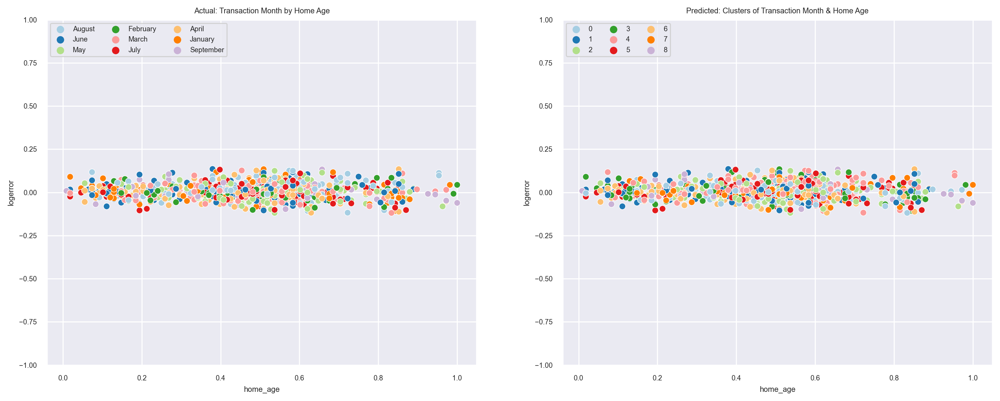

In [95]:
# seeing how clusters compare against actual month & home age plots

plt.subplots(1, 2, figsize = (16, 6), sharex = True, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "home_age",
        y = "logerror",
        data = train_imputed.sample(1000, random_state = 14), 
        hue = "transaction_month",
        # hue_order = [
        # 'January',
        # 'August',
        # 'April',
        # 'June',
        # 'May',
        # 'July',
        # 'March',
        # 'February',
        # 'September'],
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
)

plt.title("Actual: Transaction Month by Home Age")
plt.legend(loc = 'upper left', ncol = 3)
plt.ylim(-1, 1)

plt.subplot(122)
sns.scatterplot(
        x = "home_age",
        y = "logerror",
        data = train_imputed.sample(1000, random_state = 14), 
        hue = "month_clusters",
        # hue_order = [0, 1, 2, 3, 4, 5, 6, 7, 8],
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
)

plt.title("Predicted: Clusters of Transaction Month & Home Age")
plt.legend(loc = 'upper left', ncol = 3)
plt.ylim(-1, 1)
plt.show()

----
### <u>``2nd Cluster: Build Era and Living Sq. Feet``</u>

In [96]:
# checking the df head

train_dummy.columns.tolist()

['parcel_id',
 'home_value',
 'logerror',
 'living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built',
 'home_age',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_1.0',
 'bathroom_count_1.5',
 'bathroom_count_2.0',
 'bathroom_count_2.5',
 'bathroom_count_3.0',
 'bathroom_count_3.5',
 'bathroom_count_4.0',
 'bathroom_count_4.5',
 'bedroom_count_1.0',
 'bedroom_count_2.0',
 'bedroom_count_3.0',
 'bedroom_count_4.0',
 'bedroom_count_5.0',
 'county_by_fips_LA County',
 'county_by_fips_Orange County',
 'county_by_fips_Ventura County',
 'living_sqfeet_binn

In [97]:
# generating second (2) cluster: build era and living sq feet

X_era = train_dummy[[
    'living_sq_feet',
    'home_age_binned_new_century',
    'home_age_binned_late_20th_century',
    'home_age_binned_mid_20th_century',
    'home_age_binned_early_20th_century']]

val_era = validate_dummy[[
    'living_sq_feet',
    'home_age_binned_new_century',
    'home_age_binned_late_20th_century',
    'home_age_binned_mid_20th_century',
    'home_age_binned_early_20th_century']]

test_era = test_dummy[[
    'living_sq_feet',
    'home_age_binned_new_century',
    'home_age_binned_late_20th_century',
    'home_age_binned_mid_20th_century',
    'home_age_binned_early_20th_century']]


X_era.head()

,living_sq_feet,home_age_binned_new_century,home_age_binned_late_20th_century,home_age_binned_mid_20th_century,home_age_binned_early_20th_century
6446,0.33,False,False,True,False
34431,0.25,False,True,False,False
22887,0.75,True,False,False,False
20139,0.60,False,False,True,False
22438,0.74,True,False,False,False


In [98]:
# creating the KMeans cluster object

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_era)

clusters = kmeans.predict(X_era)
clusters

array([1, 2, 0, ..., 0, 1, 0], dtype=int32)

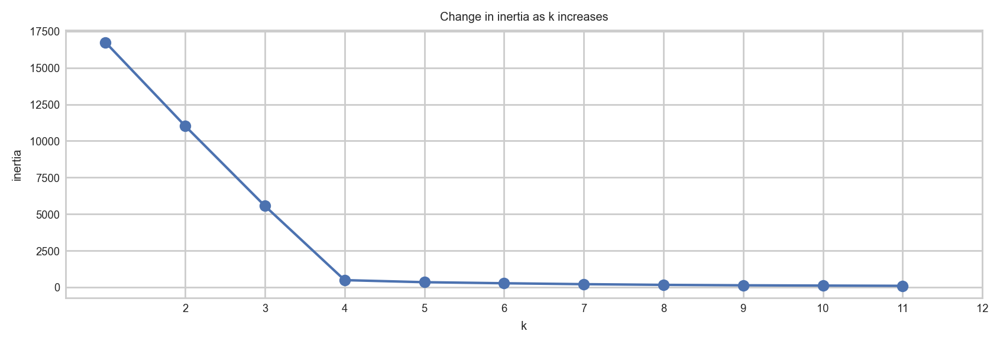

In [99]:
with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k).fit(X_era).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

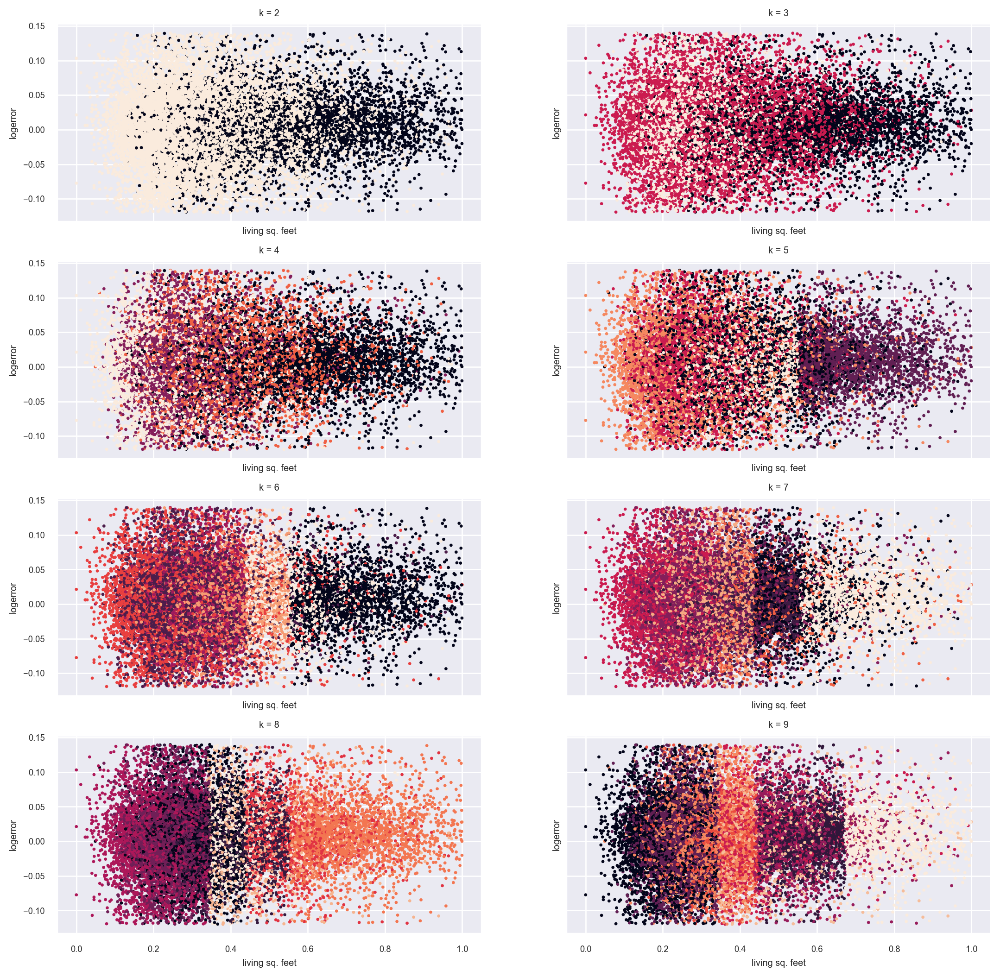

In [100]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 10)):
    # creating and fitting KMeans
    clusters = KMeans(k).fit(X_era).predict(X_era)

    X_era["logerror"] = train_dummy["logerror"]

    ax.scatter(
        X_era["living_sq_feet"], 
        X_era["logerror"], 
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'living sq. feet', ylabel = 'logerror')

In [101]:
# cleaning target in KMeans cluster 

X_era = X_era.drop(columns = "logerror")

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_era)

train_era_clusters = kmeans.predict(X_era)
validate_era_clusters = kmeans.predict(val_era)
test_era_clusters = kmeans.predict(test_era)

train_clusters

array([7, 1, 3, ..., 2, 2, 6], dtype=int32)

In [102]:
# checking the df head
X_era.head()

,living_sq_feet,home_age_binned_new_century,home_age_binned_late_20th_century,home_age_binned_mid_20th_century,home_age_binned_early_20th_century
6446,0.33,False,False,True,False
34431,0.25,False,True,False,False
22887,0.75,True,False,False,False
20139,0.60,False,False,True,False
22438,0.74,True,False,False,False


In [103]:
# adding clusters to original datasets

train_imputed["era_clusters"] = train_era_clusters
validate_imputed["era_clusters"] = validate_era_clusters
test_imputed["era_clusters"] = test_era_clusters

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter,month_clusters,era_clusters
6446,11013745,102253.00,-0.07,2.00,4.00,0.33,LA County,0.69,0.48,0.82,0101,0.00,0.47,0.53,February,mid_20th_century,1241_to_1565_sqfeet,q1_transaction,7,2
34431,14174225,452706.00,0.04,2.00,1.00,0.25,Orange County,0.41,0.82,0.16,122,0.30,0.60,0.40,June,late_20th_century,360_to_1240_sqfeet,q2_transaction,1,0
22887,14275774,425084.00,-0.02,3.50,4.00,0.75,Orange County,0.20,0.80,0.21,122,0.30,0.78,0.22,May,new_century,2037_to_3855_sqfeet,q2_transaction,2,1
20139,10955293,143359.00,0.01,3.00,4.00,0.60,LA County,0.63,0.57,0.46,0101,0.00,0.40,0.60,April,mid_20th_century,2037_to_3855_sqfeet,q2_transaction,6,2
22438,14140584,976000.00,0.07,4.50,5.00,0.74,Orange County,0.40,0.81,0.35,122,0.30,0.84,0.16,May,new_century,2037_to_3855_sqfeet,q2_transaction,2,1


In [104]:
# mean log error per home era

pd.DataFrame(train_imputed.groupby("home_age_binned")["logerror"].mean()).sort_index()

,logerror
home_age_binned,
new_century,0.01
late_20th_century,0.01
mid_20th_century,0.00
early_20th_century,0.00


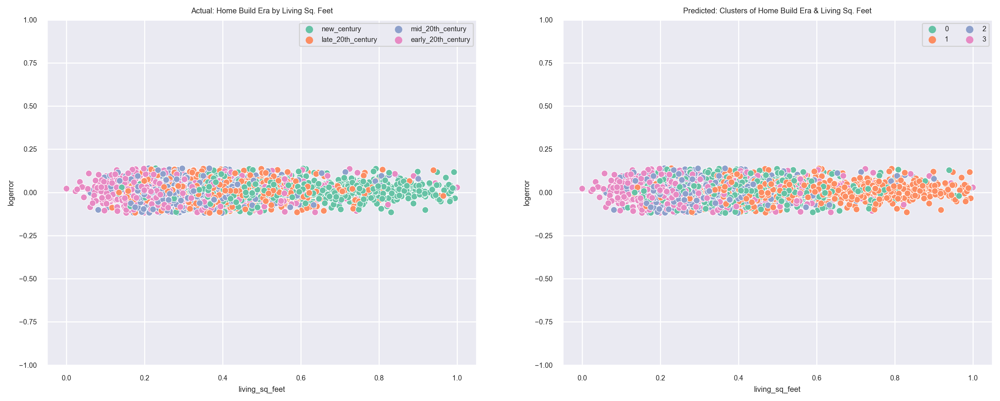

In [105]:
# seeing how clusters compare against actual month & home age plots

plt.subplots(1, 2, figsize = (16, 6), sharex = True, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "living_sq_feet",
        y = "logerror",
        data = train_imputed.sample(5000, random_state = 14),
        hue = "home_age_binned",
        # hue_order = ["early_20th_century", "late_20th_century", "mid_20th_century", "new_century"],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']
)


plt.title("Actual: Home Build Era by Living Sq. Feet")
plt.legend(loc = 'upper right', ncol = 2)
plt.ylim(-1, 1)

plt.subplot(122)
sns.scatterplot(
        x = "living_sq_feet",
        y = "logerror",
        data = train_imputed.sample(5000, random_state = 14), 
        hue = "era_clusters",
        # hue_order = [0, 1, 2, 3],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']
)

# 0 = early 20th
# 1 = new century
# 2 = mid century
# 3 = late 19th

plt.title("Predicted: Clusters of Home Build Era & Living Sq. Feet")
plt.legend(loc = 'upper right', ncol = 2)
plt.ylim(-1, 1)
plt.show()

----
### <u>``3rd Cluster: Size of Homes Binned and Home Age``</u>

In [106]:
# checking the df columns

train_dummy.columns.tolist()

['parcel_id',
 'home_value',
 'logerror',
 'living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built',
 'home_age',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_1.0',
 'bathroom_count_1.5',
 'bathroom_count_2.0',
 'bathroom_count_2.5',
 'bathroom_count_3.0',
 'bathroom_count_3.5',
 'bathroom_count_4.0',
 'bathroom_count_4.5',
 'bedroom_count_1.0',
 'bedroom_count_2.0',
 'bedroom_count_3.0',
 'bedroom_count_4.0',
 'bedroom_count_5.0',
 'county_by_fips_LA County',
 'county_by_fips_Orange County',
 'county_by_fips_Ventura County',
 'living_sqfeet_binn

In [107]:
# seeting X features for home size cluster

X_home_size = train_dummy[[ 
    'home_age',
    'living_sqfeet_binned_360_to_1240_sqfeet',
    'living_sqfeet_binned_1241_to_1565_sqfeet',
    'living_sqfeet_binned_1566_to_2036_sqfeet',
    'living_sqfeet_binned_2037_to_3855_sqfeet'
]]

val_home_size = validate_dummy[[ 
    'home_age',
    'living_sqfeet_binned_360_to_1240_sqfeet',
    'living_sqfeet_binned_1241_to_1565_sqfeet',
    'living_sqfeet_binned_1566_to_2036_sqfeet',
    'living_sqfeet_binned_2037_to_3855_sqfeet'
]]

test_home_size = test_dummy[[ 
    'home_age',
    'living_sqfeet_binned_360_to_1240_sqfeet',
    'living_sqfeet_binned_1241_to_1565_sqfeet',
    'living_sqfeet_binned_1566_to_2036_sqfeet',
    'living_sqfeet_binned_2037_to_3855_sqfeet'
]]

X_home_size.head()

,home_age,living_sqfeet_binned_360_to_1240_sqfeet,living_sqfeet_binned_1241_to_1565_sqfeet,living_sqfeet_binned_1566_to_2036_sqfeet,living_sqfeet_binned_2037_to_3855_sqfeet
6446,0.53,False,True,False,False
34431,0.40,True,False,False,False
22887,0.22,False,False,False,True
20139,0.60,False,False,False,True
22438,0.16,False,False,False,True


In [108]:
# creating the KMeans cluster object

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_home_size)

clusters = kmeans.predict(X_home_size)
clusters

array([3, 1, 2, ..., 0, 1, 3], dtype=int32)

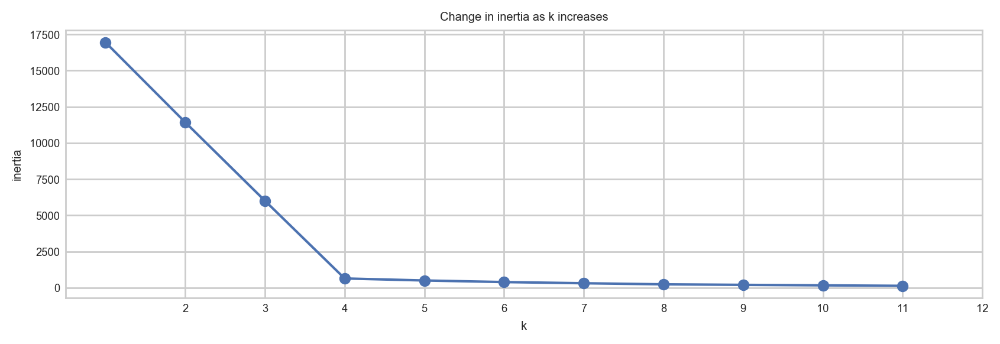

In [109]:
with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k).fit(X_home_size).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

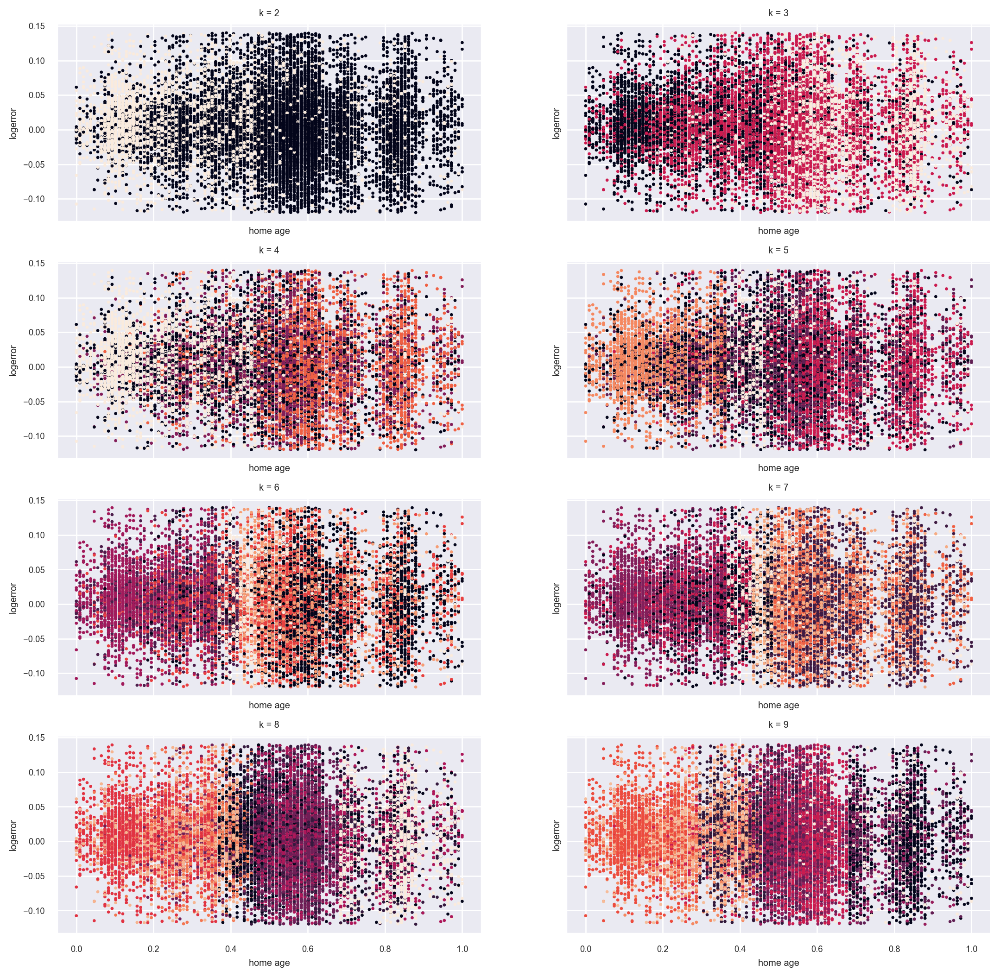

In [110]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 10)):
    # creating and fitting KMeans
    clusters = KMeans(k).fit(X_home_size).predict(X_home_size)

    X_home_size["logerror"] = train_dummy["logerror"]

    ax.scatter(
        X_home_size["home_age"], 
        X_home_size["logerror"], 
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'home age', ylabel = 'logerror')

In [111]:
# cleaning target in KMeans cluster 

X_home_size = X_home_size.drop(columns = "logerror")

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_home_size)

train_size_clusters = kmeans.predict(X_home_size)
val_size_clusters = kmeans.predict(val_home_size)
test_size_clusters = kmeans.predict(test_home_size)

train_size_clusters

array([1, 3, 0, ..., 2, 3, 1], dtype=int32)

In [112]:
# checking df head

X_home_size.head() # checks out!

,home_age,living_sqfeet_binned_360_to_1240_sqfeet,living_sqfeet_binned_1241_to_1565_sqfeet,living_sqfeet_binned_1566_to_2036_sqfeet,living_sqfeet_binned_2037_to_3855_sqfeet
6446,0.53,False,True,False,False
34431,0.40,True,False,False,False
22887,0.22,False,False,False,True
20139,0.60,False,False,False,True
22438,0.16,False,False,False,True


In [113]:
# adding clusters to original datasets

train_imputed["size_clusters"] = train_size_clusters
validate_imputed["size_clusters"] = val_size_clusters
test_imputed["size_clusters"] = test_size_clusters

train_imputed.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,...,blockgroup_assignment,year_built,home_age,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter,month_clusters,era_clusters,size_clusters
6446,11013745,102253.00,-0.07,2.00,4.00,0.33,LA County,0.69,0.48,0.82,...,0.00,0.47,0.53,February,mid_20th_century,1241_to_1565_sqfeet,q1_transaction,7,2,1
34431,14174225,452706.00,0.04,2.00,1.00,0.25,Orange County,0.41,0.82,0.16,...,0.30,0.60,0.40,June,late_20th_century,360_to_1240_sqfeet,q2_transaction,1,0,3
22887,14275774,425084.00,-0.02,3.50,4.00,0.75,Orange County,0.20,0.80,0.21,...,0.30,0.78,0.22,May,new_century,2037_to_3855_sqfeet,q2_transaction,2,1,0
20139,10955293,143359.00,0.01,3.00,4.00,0.60,LA County,0.63,0.57,0.46,...,0.00,0.40,0.60,April,mid_20th_century,2037_to_3855_sqfeet,q2_transaction,6,2,0
22438,14140584,976000.00,0.07,4.50,5.00,0.74,Orange County,0.40,0.81,0.35,...,0.30,0.84,0.16,May,new_century,2037_to_3855_sqfeet,q2_transaction,2,1,0


In [114]:
# log error mean by home size bins

pd.DataFrame(train_imputed.groupby("living_sqfeet_binned")["logerror"].mean()).sort_index()

,logerror
living_sqfeet_binned,
360_to_1240_sqfeet,0.00
1241_to_1565_sqfeet,0.00
1566_to_2036_sqfeet,0.01
2037_to_3855_sqfeet,0.01


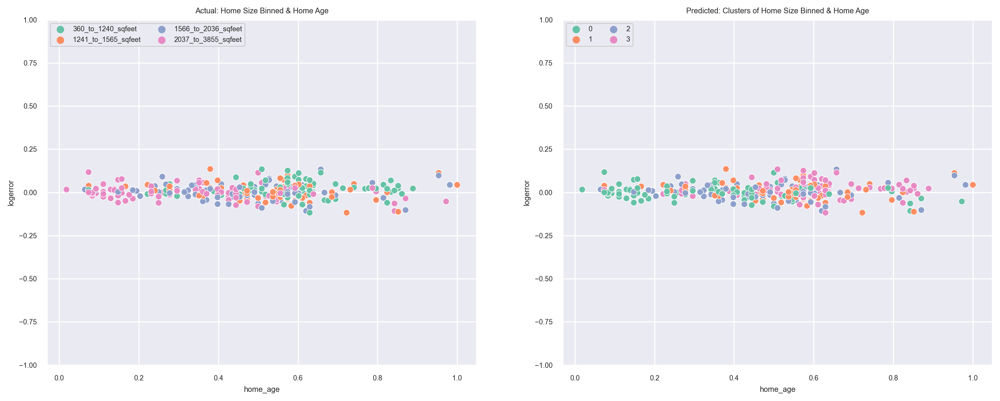

In [115]:
# seeing how clusters compare against actual month & home age plots

plt.subplots(1, 2, figsize = (16, 6), sharex = True, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "home_age",
        y = "logerror",
        data = train_imputed.sample(300, random_state = 14),
        hue = "living_sqfeet_binned",
        # hue_order = ["360_to_1240_sqfeet", "1241_to_1565_sqfeet", "1566_to_2036_sqfeet", "2037_to_3855_sqfeet"],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3'],
)

plt.title("Actual: Home Size Binned & Home Age")
plt.legend(loc = 'upper left', ncol = 2)
plt.ylim(-1, 1)

plt.subplot(122)
sns.scatterplot(
        x = "home_age",
        y = "logerror",
        data = train_imputed.sample(300, random_state = 14), 
        hue = "size_clusters",
        # hue_order = [0, 1, 2, 3],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']
)

plt.title("Predicted: Clusters of Home Size Binned & Home Age")
plt.legend(loc = 'upper left', ncol = 2)
plt.ylim(-1, 1)
plt.show()

---- 
### ``Cluster Exploration``

In [116]:
# let's check the df head

train_imputed.columns.tolist()

['parcel_id',
 'home_value',
 'logerror',
 'bathroom_count',
 'bedroom_count',
 'living_sq_feet',
 'county_by_fips',
 'latitude',
 'longitude',
 'property_sq_feet',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built',
 'home_age',
 'transaction_month',
 'home_age_binned',
 'living_sqfeet_binned',
 'transaction_quarter',
 'month_clusters',
 'era_clusters',
 'size_clusters']

In [117]:
# checking the df shape

train_imputed.shape

(21443, 21)

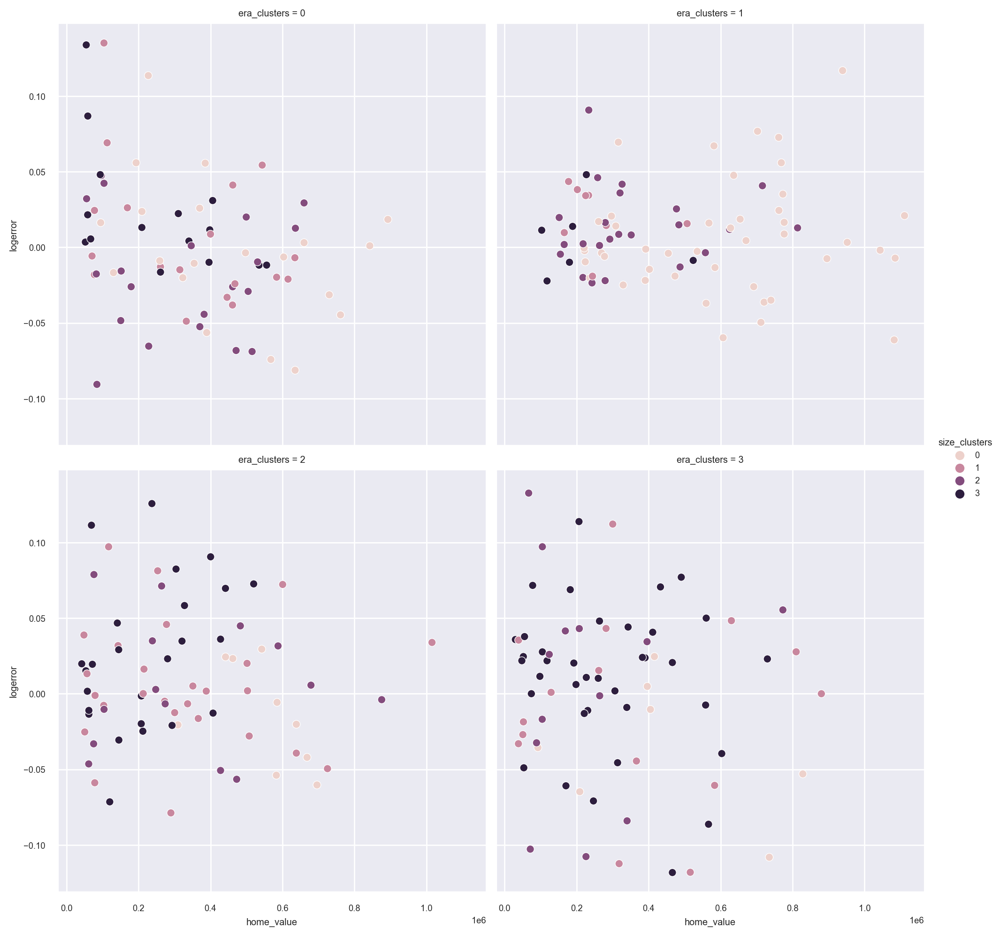

In [118]:
# plotting clusters
# era cluster first

sns.relplot(data = train_imputed.sample(300, random_state = 14), x = "home_value", y = "logerror", col = "era_clusters", hue = "size_clusters", col_wrap = 2)
plt.show()

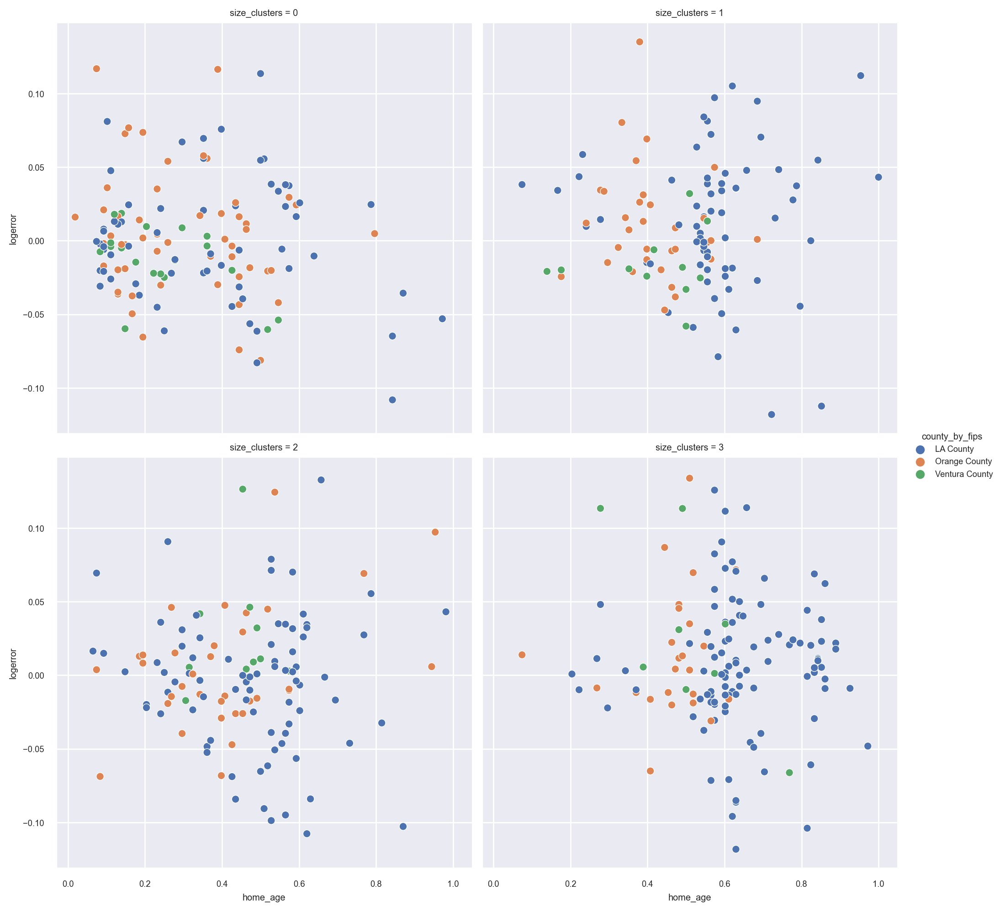

In [119]:
# plotting clusters
# month clusters

sns.relplot(data = train_imputed.sample(500, random_state = 14), x = "home_age", y = "logerror", col = "size_clusters", hue = "county_by_fips", col_wrap = 2)
plt.show()

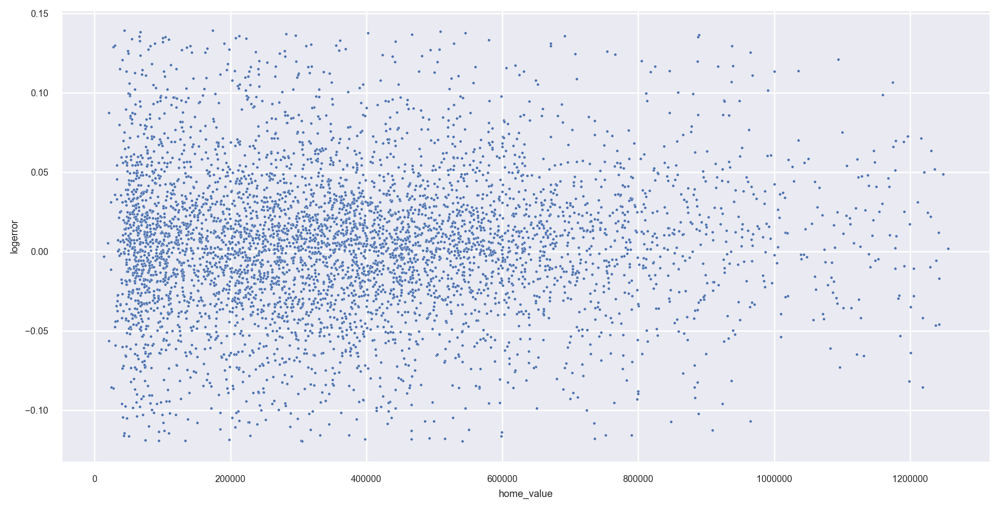

In [120]:
plt.figure(figsize = (12, 6))
ax = sns.scatterplot(
    x = "home_value", 
    y = "logerror", 
    data = train_imputed.sample(5000, random_state = 14), 
    s = 4)

ax.ticklabel_format(style = "plain") 
plt.show()

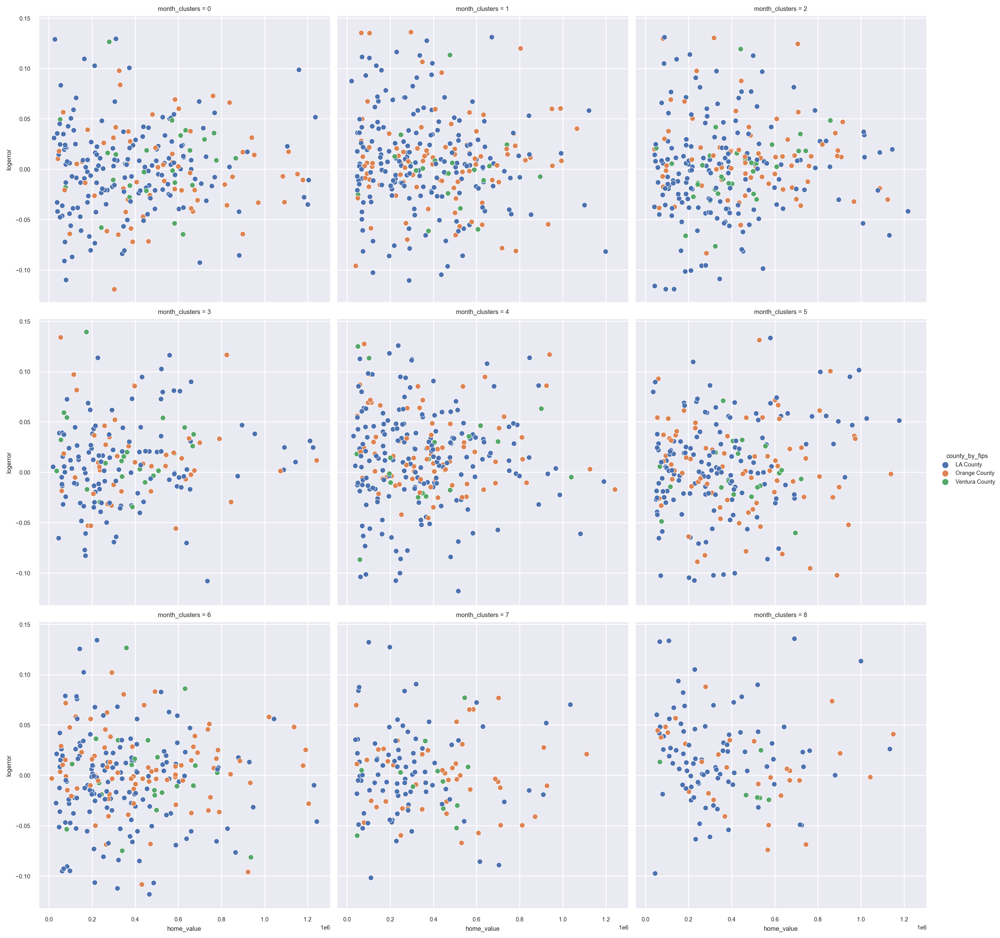

In [121]:
# plotting clusters
# month clusters

sns.relplot(data = train_imputed.sample(2000, random_state = 14), x = "home_value", y = "logerror", col = "month_clusters", hue = "county_by_fips", col_wrap = 3)
plt.show()

In [122]:
# creating dummy dataframes with generated clusters

# train dataset
train_dummy = pd.get_dummies(data = train_imputed, columns = [
    'transaction_month',
    'county_by_fips',
    'home_age_binned',
    'living_sqfeet_binned',
    'bathroom_count',
    'bedroom_count',
    'month_clusters',
    'era_clusters',
    'size_clusters'],
    drop_first = False, 
    dtype = bool)

# validate dataset
validate_dummy = pd.get_dummies(data = validate_imputed, columns = [
    'transaction_month',
    'county_by_fips',
    'home_age_binned',
    'living_sqfeet_binned',
    'bathroom_count',
    'bedroom_count',
    'month_clusters',
    'era_clusters',
    'size_clusters'],
    drop_first = False, 
    dtype = bool)

# test dataset
test_dummy = pd.get_dummies(data = test_imputed, columns = [
    'transaction_month',
    'county_by_fips',
    'home_age_binned',
    'living_sqfeet_binned',
    'bathroom_count',
    'bedroom_count',
    'month_clusters',
    'era_clusters',
    'size_clusters'],
    drop_first = False, 
    dtype = bool)

In [123]:
# checking the dataframe

train_dummy.head()

,parcel_id,home_value,logerror,living_sq_feet,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,...,month_clusters_7,month_clusters_8,era_clusters_0,era_clusters_1,era_clusters_2,era_clusters_3,size_clusters_0,size_clusters_1,size_clusters_2,size_clusters_3
6446,11013745,102253.00,-0.07,0.33,0.69,0.48,0.82,0101,0.00,0.47,...,True,False,False,False,True,False,False,True,False,False
34431,14174225,452706.00,0.04,0.25,0.41,0.82,0.16,122,0.30,0.60,...,False,False,True,False,False,False,False,False,False,True
22887,14275774,425084.00,-0.02,0.75,0.20,0.80,0.21,122,0.30,0.78,...,False,False,False,True,False,False,True,False,False,False
20139,10955293,143359.00,0.01,0.60,0.63,0.57,0.46,0101,0.00,0.40,...,False,False,False,False,True,False,True,False,False,False
22438,14140584,976000.00,0.07,0.74,0.40,0.81,0.35,122,0.30,0.84,...,False,False,False,True,False,False,True,False,False,False


In [124]:
# checking the shape

train_dummy.shape

(21443, 62)

In [125]:
# establishing logerror baseline

def establish_baseline(train, validate):

    baseline = round(train["logerror"].mean(), 2)

    train['baseline'] = baseline
    validate['baseline'] = baseline

    train_rmse = sqrt(mean_squared_error(train.logerror, train.baseline))
    validate_rmse = sqrt(mean_squared_error(validate.logerror, validate.baseline))

    print('Train baseline RMSE: {:.2f}'.format(train_rmse))
    print('Validate baseline RMSE: {:.2f}'.format(validate_rmse))

    train = train.drop(columns = "baseline")
    validate = validate.drop(columns = "baseline")
    print()
    print(f'train shape: {train.shape}')
    print(f'validate shape: {validate.shape}')

    return train, validate

In [126]:
# establishing dataset baselines for train and validate df

train_dummy, validate_dummy = establish_baseline(train_dummy, validate_dummy)

Train baseline RMSE: 0.05
Validate baseline RMSE: 0.05

train shape: (21443, 62)
validate shape: (9191, 62)


In [127]:
# let's first resplit the data to visualize clusters against other features
# 2nd split: splitting larger datasets into x and y variables

X_train = train_dummy.drop(columns = [
    "logerror", 
    "home_value",
    'blockgroup_assignment',
    'parcel_id',
    'transaction_quarter',
    'county_zoning_code'])

y_train = train_dummy["logerror"]

X_validate = validate_dummy.drop(columns = [
    "logerror", 
    "home_value",
    'blockgroup_assignment',
    'parcel_id',
    'transaction_quarter',
    'county_zoning_code'])

y_validate = validate_dummy["logerror"]

X_test = test_dummy.drop(columns = [
    "logerror", 
    "home_value",
    'blockgroup_assignment',
    'parcel_id',
    'transaction_quarter',
    'county_zoning_code'])
    
y_test = test_dummy["logerror"]

In [128]:
# checking the shape

print(X_train.shape)
print(y_train.shape)

(21443, 56)
(21443,)


In [129]:
X_train.dtypes

living_sq_feet                              float64
latitude                                    float64
longitude                                   float64
property_sq_feet                            float64
year_built                                  float64
home_age                                    float64
transaction_month_April                        bool
transaction_month_August                       bool
transaction_month_February                     bool
transaction_month_January                      bool
transaction_month_July                         bool
transaction_month_June                         bool
transaction_month_March                        bool
transaction_month_May                          bool
transaction_month_September                    bool
county_by_fips_LA County                       bool
county_by_fips_Orange County                   bool
county_by_fips_Ventura County                  bool
home_age_binned_new_century                    bool
home_age_bin

In [130]:
# converting category columns to object type

# X_train[["home_age_binned", "living_sqfeet_binned"]] = X_train[["home_age_binned", "living_sqfeet_binned"]].astype(object)

In [131]:
# creating a recursive feature eliminate function

def recursive_feature_eliminate(X_train, y_train, number_of_top_features):

    # initialize the ML algorithm
    lm = LinearRegression()

    rfe = RFE(lm, n_features_to_select = number_of_top_features)

    # fit the data using RFE
    rfe.fit(X_train, y_train) 

    # get the mask of the columns selected
    feature_mask = rfe.support_

    # get list of the column names
    rfe_features = X_train.iloc[:,feature_mask].columns.tolist()

    # view list of columns and their ranking
    # get the ranks using "rfe.ranking" method
    variable_ranks = rfe.ranking_

    # get the variable names
    variable_names = X_train.columns.tolist()

    # combine ranks and names into a df for clean viewing
    rfe_ranks_df = pd.DataFrame({'Feature': variable_names, 'Ranking': variable_ranks})

    # sort the df by rank
    return rfe_ranks_df.sort_values('Ranking')

In [132]:
X_train.columns.tolist()

['living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'year_built',
 'home_age',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'county_by_fips_LA County',
 'county_by_fips_Orange County',
 'county_by_fips_Ventura County',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'living_sqfeet_binned_360_to_1240_sqfeet',
 'living_sqfeet_binned_1241_to_1565_sqfeet',
 'living_sqfeet_binned_1566_to_2036_sqfeet',
 'living_sqfeet_binned_2037_to_3855_sqfeet',
 'bathroom_count_1.0',
 'bathroom_count_1.5',
 'bathroom_count_2.0',
 'bathroom_count_2.5',
 'bathroom_count_3.0',
 'bathroom_count_3.5',
 'bathroom_count_4.0',
 'bathroom_count_4.5',
 'bedroom_count_1.0',
 'bedroom_count_2.0'

In [133]:
# removing duplicate cluster columns (home_era, home_size, transaction_months)

X_train = X_train.drop(columns = [
'home_age_binned_new_century',               
'home_age_binned_late_20th_century',             
'home_age_binned_mid_20th_century',               
'home_age_binned_early_20th_century',                 
'living_sqfeet_binned_360_to_1240_sqfeet',
'living_sqfeet_binned_1241_to_1565_sqfeet',
'living_sqfeet_binned_1566_to_2036_sqfeet',
'living_sqfeet_binned_2037_to_3855_sqfeet',
'transaction_month_April',                      
'transaction_month_August',                      
'transaction_month_February',                    
'transaction_month_January',                     
'transaction_month_July',                       
'transaction_month_June',                        
'transaction_month_March',                       
'transaction_month_May',                         
'transaction_month_September',
# 'county_by_fips_LA County',
# 'county_by_fips_Orange County',
# 'county_by_fips_Ventura County',
'bathroom_count_1.0',
'bathroom_count_1.5',
'bathroom_count_2.0',
'bathroom_count_2.5',
'bathroom_count_3.0',
'bathroom_count_3.5',
'bathroom_count_4.0',
'bathroom_count_4.5',
'bedroom_count_1.0',
'bedroom_count_2.0',
'bedroom_count_3.0',
'bedroom_count_4.0',
'bedroom_count_5.0',
"year_built",
"home_age",
"living_sq_feet",
# "property_sq_feet",
# "latitude",
# "longitude",
])

X_validate = X_validate.drop(columns = [
'home_age_binned_new_century',               
'home_age_binned_late_20th_century',             
'home_age_binned_mid_20th_century',               
'home_age_binned_early_20th_century',                 
'living_sqfeet_binned_360_to_1240_sqfeet',
'living_sqfeet_binned_1241_to_1565_sqfeet',
'living_sqfeet_binned_1566_to_2036_sqfeet',
'living_sqfeet_binned_2037_to_3855_sqfeet',
'transaction_month_April',                      
'transaction_month_August',                      
'transaction_month_February',                    
'transaction_month_January',                     
'transaction_month_July',                       
'transaction_month_June',                        
'transaction_month_March',                       
'transaction_month_May',                         
'transaction_month_September',
# 'county_by_fips_LA County',
# 'county_by_fips_Orange County',
# 'county_by_fips_Ventura County',
'bathroom_count_1.0',
'bathroom_count_1.5',
'bathroom_count_2.0',
'bathroom_count_2.5',
'bathroom_count_3.0',
'bathroom_count_3.5',
'bathroom_count_4.0',
'bathroom_count_4.5',
'bedroom_count_1.0',
'bedroom_count_2.0',
'bedroom_count_3.0',
'bedroom_count_4.0',
'bedroom_count_5.0',
"year_built",
"home_age",
"living_sq_feet",
# "property_sq_feet",
# "latitude",
# "longitude",
])

X_test = X_test.drop(columns = [
'home_age_binned_new_century',               
'home_age_binned_late_20th_century',             
'home_age_binned_mid_20th_century',               
'home_age_binned_early_20th_century',                 
'living_sqfeet_binned_360_to_1240_sqfeet',
'living_sqfeet_binned_1241_to_1565_sqfeet',
'living_sqfeet_binned_1566_to_2036_sqfeet',
'living_sqfeet_binned_2037_to_3855_sqfeet',
'transaction_month_April',                      
'transaction_month_August',                      
'transaction_month_February',                    
'transaction_month_January',                     
'transaction_month_July',                       
'transaction_month_June',                        
'transaction_month_March',                       
'transaction_month_May',                         
'transaction_month_September',
# 'county_by_fips_LA County',
# 'county_by_fips_Orange County',
# 'county_by_fips_Ventura County',
'bathroom_count_1.0',
'bathroom_count_1.5',
'bathroom_count_2.0',
'bathroom_count_2.5',
'bathroom_count_3.0',
'bathroom_count_3.5',
'bathroom_count_4.0',
'bathroom_count_4.5',
'bedroom_count_1.0',
'bedroom_count_2.0',
'bedroom_count_3.0',
'bedroom_count_4.0',
'bedroom_count_5.0',
"year_built",
"home_age",
"living_sq_feet",
# "property_sq_feet",
# "latitude",
# "longitude",
])

In [134]:
# using sklearn's RFECV function to select best features to include

from sklearn.feature_selection import RFECV

# initiate, and fit

rfecv = RFECV(
    estimator = LinearRegression(),
    min_features_to_select = 5
)

rfecv = rfecv.fit(X_train, y_train)

In [135]:
feature_lst = X_train.columns[rfecv.support_].tolist()
pd.DataFrame(feature_lst).rename(columns = {0: "Features"}).sort_values("Features").reset_index(drop = True)

,Features
0,county_by_fips_LA County
1,county_by_fips_Orange County
2,county_by_fips_Ventura County
3,era_clusters_0
4,era_clusters_2
5,era_clusters_3
6,latitude
7,longitude
8,month_clusters_0
9,month_clusters_1


In [136]:
# using the recursive feature elimination function

recursive_feature_eliminate(X_train, y_train, 3).reset_index(drop = True)

,Feature,Ranking
0,latitude,1
1,size_clusters_0,1
2,month_clusters_3,1
3,month_clusters_8,2
4,month_clusters_4,3
5,month_clusters_6,4
6,month_clusters_2,5
7,month_clusters_0,6
8,size_clusters_3,7
9,property_sq_feet,8


In [137]:
# selecting only identified features from RFECV 

X_train = X_train[feature_lst]
X_validate = X_validate[feature_lst]
X_test = X_test[feature_lst]

X_train.head()

,latitude,longitude,property_sq_feet,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,month_clusters_0,month_clusters_1,month_clusters_2,month_clusters_3,...,month_clusters_6,month_clusters_7,month_clusters_8,era_clusters_0,era_clusters_2,era_clusters_3,size_clusters_0,size_clusters_1,size_clusters_2,size_clusters_3
6446,0.69,0.48,0.82,True,False,False,False,False,False,False,...,False,True,False,False,True,False,False,True,False,False
34431,0.41,0.82,0.16,False,True,False,False,True,False,False,...,False,False,False,True,False,False,False,False,False,True
22887,0.20,0.80,0.21,False,True,False,False,False,True,False,...,False,False,False,False,False,False,True,False,False,False
20139,0.63,0.57,0.46,True,False,False,False,False,False,False,...,True,False,False,False,True,False,True,False,False,False
22438,0.40,0.81,0.35,False,True,False,False,False,True,False,...,False,False,False,False,False,False,True,False,False,False


In [138]:
# generating models using selected RFE features

lr = LinearRegression()
lr_model = lr.fit(X_train, y_train)

lars = LassoLars()
lars_model = lars.fit(X_train, y_train)

glm = TweedieRegressor(alpha = 1, power = 0)
glm_model = glm.fit(X_train, y_train)

print("Training R-squared w/Linear Regression:", lr_model.score(X_train, y_train).round(4))
print("Training R-squared w/Lasso Lars:", lars_model.score(X_train, y_train).round(4))
print("Training R-squared w/Tweedie Regressor:", glm_model.score(X_train, y_train).round(4))

Training R-squared w/Linear Regression: 0.0112
Training R-squared w/Lasso Lars: 0.0
Training R-squared w/Tweedie Regressor: 0.0033


In [139]:
# checking the shape 

X_train.shape

(21443, 22)

In [140]:
# Polynomial regression model
# 1. Generate Polynomial Features

poly = PolynomialFeatures(degree = 2, include_bias = False)
poly.fit(X_train)

X_train_poly = pd.DataFrame(
    poly.transform(X_train),
    columns = poly.get_feature_names(X_train.columns),
    index = train.index,
)

X_train_poly.head()

,latitude,longitude,property_sq_feet,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,month_clusters_0,month_clusters_1,month_clusters_2,month_clusters_3,...,size_clusters_0^2,size_clusters_0 size_clusters_1,size_clusters_0 size_clusters_2,size_clusters_0 size_clusters_3,size_clusters_1^2,size_clusters_1 size_clusters_2,size_clusters_1 size_clusters_3,size_clusters_2^2,size_clusters_2 size_clusters_3,size_clusters_3^2
6446,0.69,0.48,0.82,1.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00
34431,0.41,0.82,0.16,0.00,1.00,0.00,0.00,1.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00
22887,0.20,0.80,0.21,0.00,1.00,0.00,0.00,0.00,1.00,0.00,...,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
20139,0.63,0.57,0.46,1.00,0.00,0.00,0.00,0.00,0.00,0.00,...,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
22438,0.40,0.81,0.35,0.00,1.00,0.00,0.00,0.00,1.00,0.00,...,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00


In [141]:
# creating a dataframe with y_train

predictions = pd.DataFrame({
    'logerror actual': y_validate
})
predictions.head()

,logerror actual
7055,-0.04
28796,-0.02
42431,-0.03
39139,0.01
10590,0.07


In [142]:
# baseline mean predictions

baseline = predictions["logerror actual"].mean()
predictions["baseline_predictions"] = baseline
predictions.head()

,logerror actual,baseline_predictions
7055,-0.04,0.01
28796,-0.02,0.01
42431,-0.03,0.01
39139,0.01,0.01
10590,0.07,0.01


In [143]:
# checking validate df
X_validate.head()

,latitude,longitude,property_sq_feet,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,month_clusters_0,month_clusters_1,month_clusters_2,month_clusters_3,...,month_clusters_6,month_clusters_7,month_clusters_8,era_clusters_0,era_clusters_2,era_clusters_3,size_clusters_0,size_clusters_1,size_clusters_2,size_clusters_3
7055,0.47,0.57,0.47,True,False,False,False,False,False,False,...,False,True,False,False,False,True,False,False,True,False
28796,0.95,0.62,0.70,True,False,False,False,True,False,False,...,False,False,False,False,False,False,True,False,False,False
42431,0.57,0.83,0.42,True,False,False,False,False,False,False,...,False,False,False,False,True,False,False,True,False,False
39139,0.37,0.68,0.36,True,False,False,False,False,False,False,...,False,False,False,False,True,False,False,False,False,True
10590,0.62,0.63,0.40,True,False,False,True,False,False,False,...,False,False,False,False,False,True,False,False,False,True


In [144]:
# 2. Use the features

lm_poly = LinearRegression()
lm_poly.fit(X_train_poly, y_train)


X_validate_poly = poly.transform(X_validate)
predictions['polynomial degree 2'] = lm_poly.predict(X_validate_poly)
predictions.head()

,logerror actual,baseline_predictions,polynomial degree 2
7055,-0.04,0.01,0.01
28796,-0.02,0.01,-0.00
42431,-0.03,0.01,0.01
39139,0.01,0.01,0.00
10590,0.07,0.01,0.00


In [145]:
# evaluating polynomial regression deg. 2 model

model_performance = []

train_model = lm_poly.predict(X_train_poly)
rmse_train = sqrt(mean_squared_error(y_train, train_model))

validate_model = lm_poly.predict(X_validate_poly)
rmse_validate = sqrt(mean_squared_error(y_validate, validate_model))

metrics = {
    "model": "Polynomial deg.2",
    "train_rmse": rmse_train,
    "validate_rmse": rmse_validate}

model_performance.append(metrics)

print('RMSE for Polynomial Deg. 2 model on the train dataset: {:.2f}'.format(rmse_train))
print('RMSE for Polynomial Deg. 2 model on the validate dataset: {:.2f}'.format(rmse_validate))


RMSE for Polynomial Deg. 2 model on the train dataset: 0.04
RMSE for Polynomial Deg. 2 model on the validate dataset: 0.04


In [146]:
models = [lr_model, lars_model, glm_model]

for model in models:

    train_model = model.predict(X_train)
    rmse_train = sqrt(mean_squared_error(y_train,
                                         train_model))
    
    validate_model = model.predict(X_validate)
    rmse_validate = sqrt(mean_squared_error(y_validate,
                                         validate_model))
    
    metrics = {
    "model": str(model),
    "train_rmse": rmse_train,
    "validate_rmse": rmse_validate}

    model_performance.append(metrics)


    print('RMSE for {} model on the train dataset: {}'.format(model, round(rmse_train, 2)))
    print('RMSE for {} model on the validate dataset: {}'.format(model, round(rmse_validate, 2)))
    print()

RMSE for LinearRegression() model on the train dataset: 0.05
RMSE for LinearRegression() model on the validate dataset: 0.04

RMSE for LassoLars() model on the train dataset: 0.05
RMSE for LassoLars() model on the validate dataset: 0.05

RMSE for TweedieRegressor(alpha=1, power=0) model on the train dataset: 0.05
RMSE for TweedieRegressor(alpha=1, power=0) model on the validate dataset: 0.05



In [147]:
# returning the models performance 

model_performance = pd.DataFrame(model_performance)
model_performance["model"] = model_performance["model"].replace({"LinearRegression()": "LinearRegression", "LassoLars()": "LassoLars", "TweedieRegressor(alpha=1, power=0)": "TweedieRegressor"})

In [148]:
model_performance

,model,train_rmse,validate_rmse
0,Polynomial deg.2,0.04,0.04
1,LinearRegression,0.05,0.04
2,LassoLars,0.05,0.05
3,TweedieRegressor,0.05,0.05


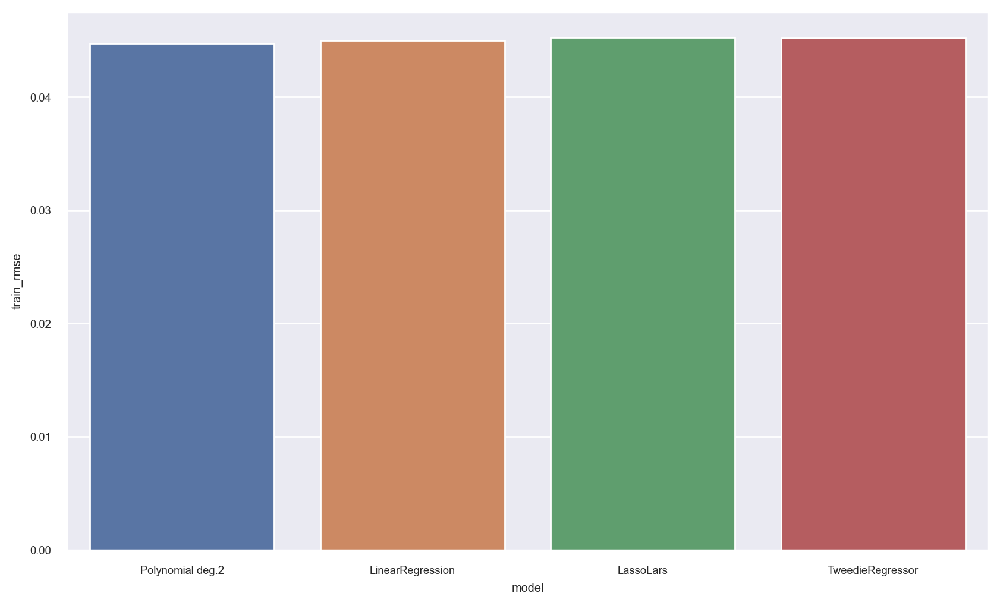

In [168]:

plt.figure(figsize = (10, 6))

sns.barplot(x = "model", y = "train_rmse", data = model_performance)
# plt.bar(x = "model", y = "validate_rmse", data = model_performance, height = 8, label = "validate")


plt.show()

In [171]:
# generating validate model predictions and assigning to dataframe

lr_predictions = lr_model.predict(X_validate)
predictions["linear_predictions"] = lr_predictions.round(2)

lars_predictions = lars_model.predict(X_validate)
predictions["lars_predictions"] = lars_predictions.round(2)

glm_predictions = lars_model.predict(X_validate)
predictions["glm_predictions"] = glm_predictions.round(2)

In [172]:
# generating error reports for all models and baseline:

SSE, ESS, TSS, MSE, RMSE = acquire.get_error_report(predictions["logerror actual"], predictions["polynomial degree 2"])
print()
SSE, ESS, TSS, MSE, RMSE = acquire.get_error_report(predictions["logerror actual"], predictions["linear_predictions"])
print()
SSE, ESS, TSS, MSE, RMSE = acquire.get_error_report(predictions["logerror actual"], predictions["lars_predictions"])
print()
SSE, ESS, TSS, MSE, RMSE = acquire.get_error_report(predictions["logerror actual"], predictions["glm_predictions"])
print()
SSE, ESS, TSS, MSE, RMSE = acquire.get_error_report(predictions["logerror actual"], predictions["baseline_predictions"])

polynomial degree 2 SSE: 18.669599999999683
polynomial degree 2 ESS: 0.45106499511600384
polynomial degree 2 TSS: 19.120664995115686
polynomial degree 2 MSE: 0.002031291480796397
polynomial degree 2 RMSE: 0.04506985112906849

linear_predictions SSE: 18.678699999999804
linear_predictions ESS: 0.28219020467839145
linear_predictions TSS: 18.960890204678194
linear_predictions MSE: 0.002032281579806311
linear_predictions RMSE: 0.04508083384107165

lars_predictions SSE: 18.970099999999704
lars_predictions ESS: 0.1775918969769073
lars_predictions TSS: 19.14769189697661
lars_predictions MSE: 0.002063986508540932
lars_predictions RMSE: 0.0454311182840675

glm_predictions SSE: 18.970099999999704
glm_predictions ESS: 0.1775918969769073
glm_predictions TSS: 19.14769189697661
glm_predictions MSE: 0.002063986508540932
glm_predictions RMSE: 0.0454311182840675

baseline_predictions SSE: 18.777699999999818
baseline_predictions ESS: 0.0
baseline_predictions TSS: 18.777699999999818
baseline_predictions M

In [173]:
# checking the df

predictions.head()

,logerror actual,baseline_predictions,polynomial degree 2,linear_predictions,lars_predictions,glm_predictions
7055,-0.04,0.01,0.01,0.01,0.01,0.01
28796,-0.02,0.01,-0.00,0.01,0.01,0.01
42431,-0.03,0.01,0.01,0.00,0.01,0.01
39139,0.01,0.01,0.00,0.00,0.01,0.01
10590,0.07,0.01,0.00,-0.00,0.01,0.01
